In [1]:
%reload_ext autoreload
%autoreload 2

import copy
import os
import pickle
import diagnostics
from pathlib import Path
from datasets import *
from models import Resnet34, Resnet34FeatVis
from trainer import Trainer, Evaluator, set_seed
from trainer import CrossValidationUtils as cvu
from trainer import FeaturesVisualizationUtils, FilterVisualizationUtils
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
import random
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from metrics.confusion_matrix import *
from metrics.plot_functions import *
from metrics import Accuracy, AccuracyMulti, ROCMulti
from loss.focal_loss import *

Python version: 3.8.2 (default, Mar 25 2020, 17:03:02) 
[GCC 7.3.0]
NumPy version: 1.18.1
scikit-learn version: 0.22.1
pandas version: 1.0.3
OpenCV version: 4.2.0
Torch version: 1.4.0
Available GPUs: 2
Cuda version: 10.1
Torch device: cuda


In [2]:
# select GPU
torch.cuda.set_device(1)

In [3]:
# Fix seed to improve reproducibility
SEED = 6666
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

batch_size = 64

## Create Dataset with frame differences

In [4]:
# update MetaData file with current path for pickle files
old_root = './sacco/PKL/'    # './sacco/PKL/raw_images' and './sacco/PKL/masks'
new_root = './input/'

metadata_old = pd.read_csv('./input/Clip_MetaData.csv')
metadata_old['index_pickle'] = metadata_old['index_pickle'].str.replace(old_root, new_root)
metadata_old['index_mask'] = metadata_old['index_mask'].str.replace(old_root, new_root)
metadata_old.to_csv('./input/Clip_MetaDataUpdate.csv', index=False)

In [4]:
input_name = 'eco_50_first_diff_samplFirst_mask_256'

frame_to_keep = 50
frame_sampling = 'first_available' # 'equally_spaced' 
apply_frame_difference = True
apply_sampling_first = True  # if True, apply sampling first and then frame difference (if any). If False, reverse order
apply_mask = True
resize = 256
output_folder = os.path.join('./input/', input_name)
metadata_out = os.path.join('./input/', 'MetaData_' + input_name + '.csv')

In [5]:
# create dataset

metadata_raw = pd.read_csv('./input/Clip_MetaDataUpdate.csv')
create_model_input(metadata_raw, output_folder, metadata_out, frame_to_keep, frame_sampling, apply_frame_difference,
                   apply_sampling_first, apply_mask, resize)


Total removed: 54
    - because of color: 3
    - because of number of frames: 51

Total remaining: 678 out of 732 



,count,out of
diagnosis,,
akinetic,180,203
covid,150,159
healthy,348,370



Raw pickle folder size: 33,966 MB

Total number of frames will be: 49 

732 / 732
Total elapsed time: 0:01:58

Files saved in ./input/eco_50_first_diff_samplFirst_mask_256
Output folder size: 2,076 MB

Model metadata saved in ./input/MetaData_eco_50_first_diff_samplFirst_mask_256.csv


In [14]:
metadata = pd.read_csv(os.path.join('./input/', 'MetaData_' + input_name + '.csv'))
metadata

,keep,folder,index_pickle_final,NumberOfFrames_final,diagnosis,index_pickle,index_mask,diagnosis_covid,Frames,FrameDelay,...,PatientBirthDate,local_path,BitsAllocated,last_modified,index,PlanarConfiguration,diagnosis_akinetic,Import_Status,x_size,FrameTime
0,Keep,2020-01-01-acinesia-p-inflat,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,akinetic,./input/raw_images/BRVI49BAMEINLA3C.pickle,./input/masks/BRVI49BAMEINLA3C_mask.pickle,0,84,0.0,...,19490511.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-07-11 09:57:57+00:00,eco-scan-cardio/2020-01-01-acinesia-p-inflat/B...,0,1,OK,800,20.060000
1,Keep,2020-01-01-acinesia-p-inflat,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,akinetic,./input/raw_images/DIFR40BAMEINLA3C_protesi mi...,./input/masks/DIFR40BAMEINLA3C_protesi mitrali...,0,91,0.0,...,19401123.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-07-11 09:57:57+00:00,eco-scan-cardio/2020-01-01-acinesia-p-inflat/D...,0,1,OK,800,20.067000
2,Keep,2020-01-01-acinesia-p-inflat,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,akinetic,./input/raw_images/GRAL43BAMEINLA3C.pickle,./input/masks/GRAL43BAMEINLA3C_mask.pickle,0,93,0.0,...,19431222.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-07-11 09:57:58+00:00,eco-scan-cardio/2020-01-01-acinesia-p-inflat/G...,0,1,OK,854,19.967000
3,Keep,2020-01-01-acinesia-p-inflat,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,akinetic,./input/raw_images/GRAL43BAMEINLALAX.pickle,./input/masks/GRAL43BAMEINLALAX_mask.pickle,0,82,0.0,...,19431222.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-07-11 09:57:58+00:00,eco-scan-cardio/2020-01-01-acinesia-p-inflat/G...,0,1,OK,854,19.975000
4,Keep,2020-01-01-acinesia-p-inflat,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,akinetic,./input/raw_images/MOAN71BAINLALAX.pickle,./input/masks/MOAN71BAINLALAX_mask.pickle,0,72,0.0,...,19710515.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-07-11 09:57:58+00:00,eco-scan-cardio/2020-01-01-acinesia-p-inflat/M...,0,1,OK,1016,33.779343
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
673,Keep,2020-08-07-covid-normali,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,covid,./input/raw_images/WAME62_4C BIS.pickle,./input/masks/WAME62_4C BIS_mask.pickle,1,79,0.0,...,19620624.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-08-10 14:08:25+00:00,eco-scan-cardio/2020-08-07-covid-normali/WAME6...,0,0,OK,1024,0.000000
674,Keep,2020-08-07-covid-normali,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,covid,./input/raw_images/WAME62_4C SOTTOCOSTALE BIS....,./input/masks/WAME62_4C SOTTOCOSTALE BIS_mask....,1,68,0.0,...,19620624.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-08-10 14:08:34+00:00,eco-scan-cardio/2020-08-07-covid-normali/WAME6...,0,0,OK,1024,0.000000
675,Keep,2020-08-07-covid-normali,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,covid,./input/raw_images/WAME62_4C SOTTOCOSTALE.pickle,./input/masks/WAME62_4C SOTTOCOSTALE_mask.pickle,1,68,0.0,...,19620624.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-08-10 14:08:34+00:00,eco-scan-cardio/2020-08-07-covid-normali/WAME6...,0,0,OK,1024,0.000000
676,Keep,2020-08-07-covid-normali,./input/eco_50_first_diff_samplFirst_mask_256/...,49.0,covid,./input/raw_images/WAME62_4C_BIS.pickle,./input/masks/WAME62_4C_BIS_mask.pickle,1,80,0.0,...,19620624.0,/home/shared/datasets/defeatcovid19/sacco/eco-...,8,2020-08-10 14:08:34+00:00,eco-scan-cardio/2020-08-07-covid-normali/WAME6...,0,0,OK,1024,0.000000


## Train model Akinetic vs Rest

In [4]:
input_name = 'eco_50_first_diff_samplFirst_mask_256'
size = 256
diagnosis_class = pd.DataFrame({'diagnosis': ['akinetic', 'healthy', 'covid'],
                                'label': [1, 0, 0],
                                'meaning': ['akinetic', 'other', 'other']})


dataset = ecoSaccoDataset(input_name, diagnosis_class=diagnosis_class, diagnosis_to_keep=['akinetic', 'healthy', 'covid'],
                          size=size, show_info=True)

ecoSaccoDataset initialized with size=256, augment=None
Dataset is located in ./input/eco_50_first_diff_samplFirst_mask_256

############    eco_50_first_diff_samplFirst_mask_256 dataset    ############

Total files: 678
Total frames: 49


,image,label,meaning,source
0,./input/eco_50_first_diff_samplFirst_mask_256/...,1,akinetic,Sacco
1,./input/eco_50_first_diff_samplFirst_mask_256/...,1,akinetic,Sacco
2,./input/eco_50_first_diff_samplFirst_mask_256/...,1,akinetic,Sacco
3,./input/eco_50_first_diff_samplFirst_mask_256/...,1,akinetic,Sacco
4,./input/eco_50_first_diff_samplFirst_mask_256/...,1,akinetic,Sacco
...,...,...,...,...
673,./input/eco_50_first_diff_samplFirst_mask_256/...,0,other,Sacco
674,./input/eco_50_first_diff_samplFirst_mask_256/...,0,other,Sacco
675,./input/eco_50_first_diff_samplFirst_mask_256/...,0,other,Sacco
676,./input/eco_50_first_diff_samplFirst_mask_256/...,0,other,Sacco


,,,count
label,meaning,source,
0,other,Sacco,498
1,akinetic,Sacco,180



Used raw classifier: Resnet34

Start hyperparameter tuning


============================== BCE - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,other,Sacco,398,398,398,399,399
1,akinetic,Sacco,144,144,144,144,144



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,other,Sacco,100,100,100,99,99
1,akinetic,Sacco,36,36,36,36,36



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2ae6ea9310>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.614# 0.498  0.735  | 0.765* 0.503  0.463  |   7.32
                    |                      | 0.605# 0.526  0.732  |   7.32
0.010000   18   2.0 | 0.602# 0.498  0.735  | 0.679* 0.677  0.598  |  14.25
                    |                      | 0.618# 0.414  0.731  |  14.25
0.009000   27   3.0 | 0.639# 0.527  0.625  | 0.605* 0.811  0.673  |  21.18
       

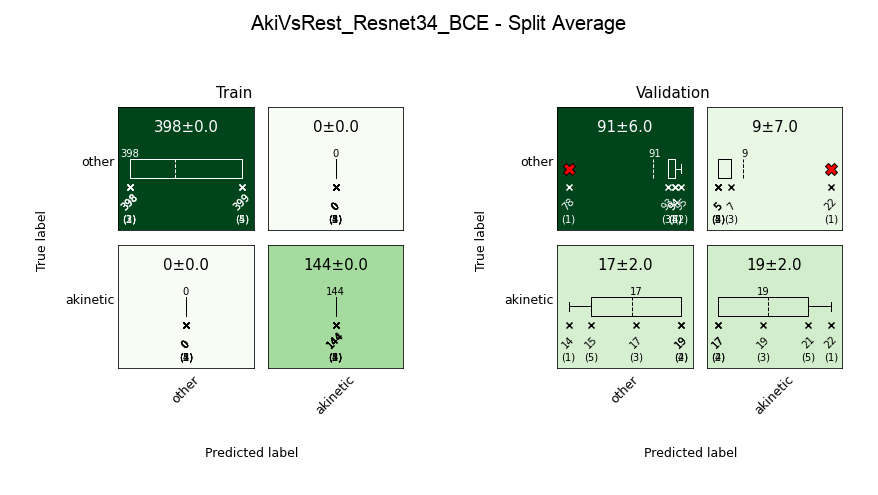



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.638 ± 0.121,0.855 ± 0.019,0.811 ± 0.044,0.003 ± 0.001,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.603 ± 0.047,1.0 ± 0.0,0.875 ± 0.036





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,other,Sacco,398,100
1,akinetic,Sacco,144,36


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2ae6ea9310>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2ac40d18b0>'
BCELoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.610# 0.496  0.735  | 0.782* 0.480  0.483  |   6.96
                    |                      | 0.617# 0.45

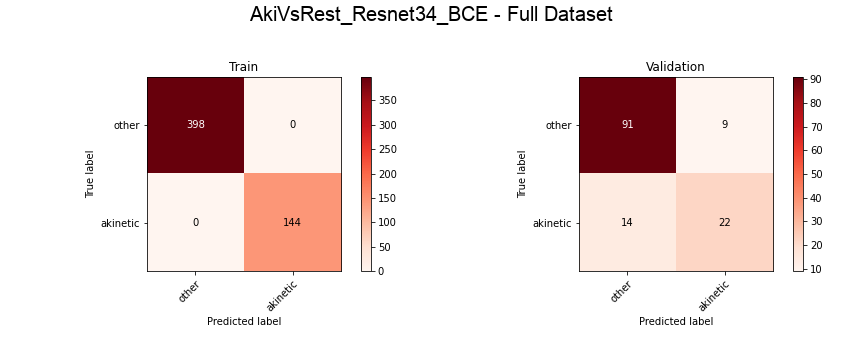

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
other                1      1      1.0     398       0.87   0.91     0.89   
akinetic             1      1      1.0     144       0.71   0.61     0.66   
accuracy                           1.0     542                       0.83   
macro avg            1      1      1.0     542       0.79   0.76     0.77   
weighted avg         1      1      1.0     542       0.83   0.83     0.83   

                      
             support  
other            100  
akinetic          36  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.638 ± 0.121,0.855 ± 0.019,0.811 ± 0.044,0.003 ± 0.001,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.603 ± 0.047,1.0 ± 0.0,0.875 ± 0.036
Full,0.593,0.879,0.831,0.002,1,1,1,0.657,1,0.888


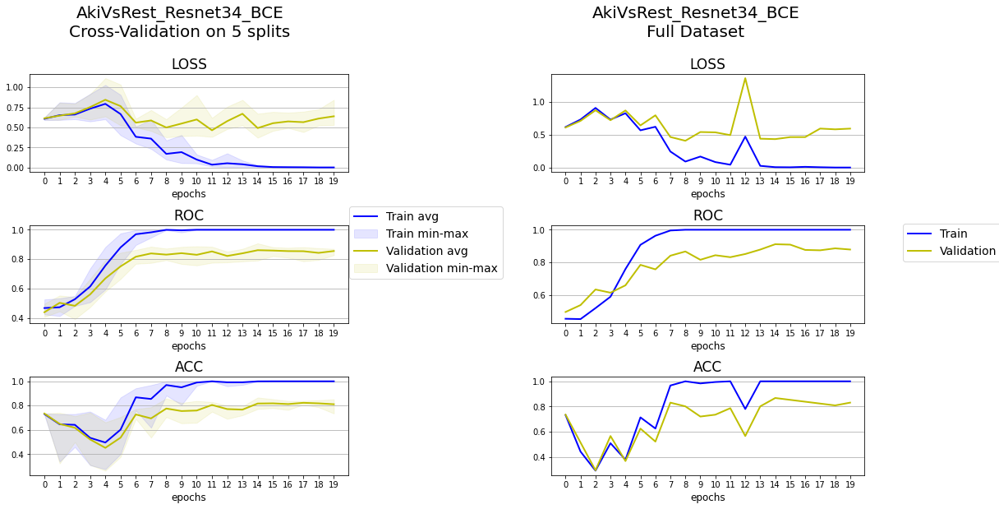

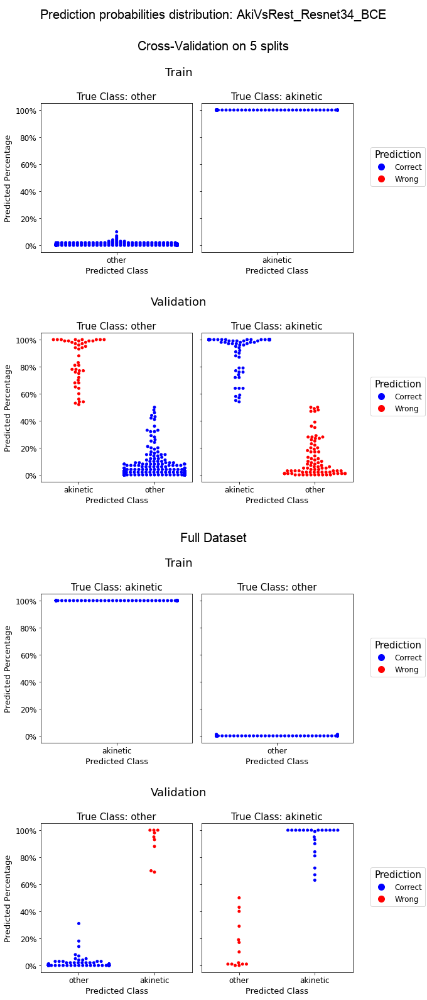



============================== BCE - InvertClass:yes ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,other,Sacco,398,398,398,399,399



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,other,Sacco,100,100,100,99,99



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a9273b430>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.854# 0.486  0.294  | 0.753* 0.476  0.485  |   6.86
                    |                      | 0.880# 0.375  0.260  |   6.86
0.010000   18   2.0 | 0.851# 0.472  0.294  | 0.701* 0.582  0.548  |  13.60
                    |                      | 0.882# 0.361  0.282  |  13.60
0.009000   27   3.0 | 0.718# 0.492  0.485  | 0.632* 0.713  0.627  |  20.40
       

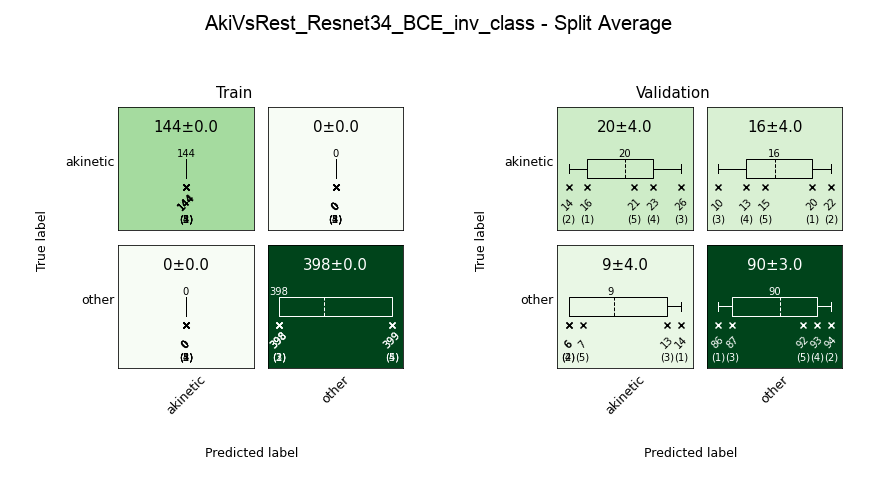



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.674 ± 0.111,0.845 ± 0.056,0.814 ± 0.043,0.002 ± 0.001,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.608 ± 0.108,1.0 ± 0.0,0.878 ± 0.028





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,other,Sacco,398,100


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a9273b430>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2a826a7b50>'
BCELoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.961# 0.665  0.265  | 0.771* 0.464  0.465  |   6.90
                    |                      | 0.967# 0.58

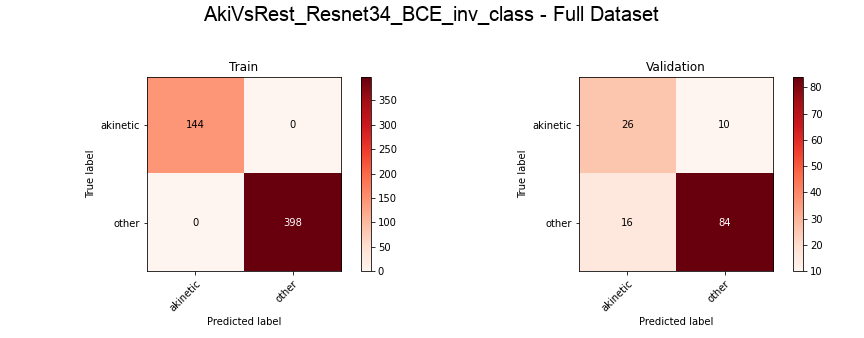

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1      1      1.0     144       0.62   0.72     0.67   
other                1      1      1.0     398       0.89   0.84     0.87   
accuracy                           1.0     542                       0.81   
macro avg            1      1      1.0     542       0.76   0.78     0.77   
weighted avg         1      1      1.0     542       0.82   0.81     0.81   

                      
             support  
akinetic          36  
other            100  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.674 ± 0.111,0.845 ± 0.056,0.814 ± 0.043,0.002 ± 0.001,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.608 ± 0.108,1.0 ± 0.0,0.878 ± 0.028
Full,0.572,0.86,0.809,0.007,1,1,1,0.667,1,0.866


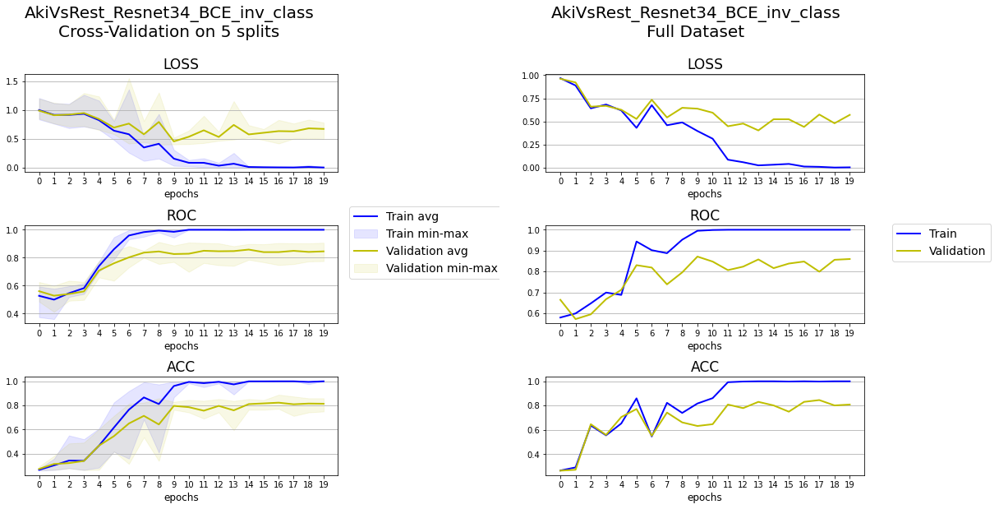

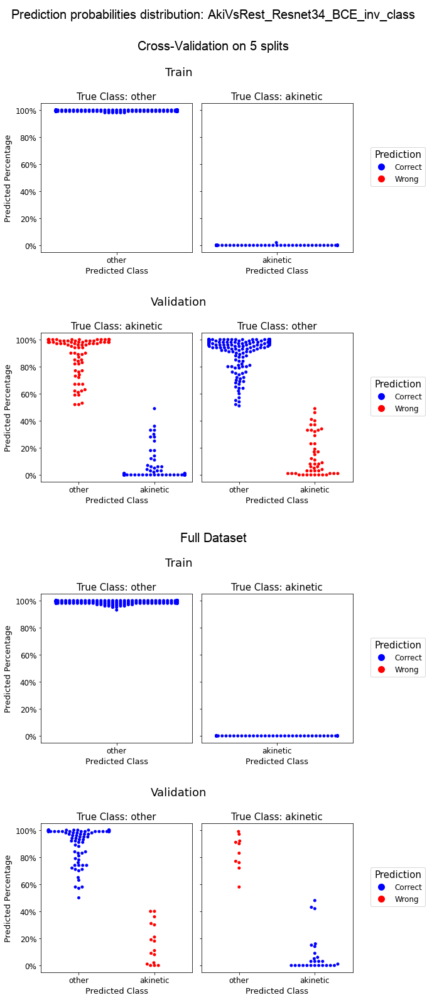



============================== FocLos - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,other,Sacco,398,398,398,399,399
1,akinetic,Sacco,144,144,144,144,144



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,other,Sacco,100,100,100,99,99
1,akinetic,Sacco,36,36,36,36,36



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2ac4738f40>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.174# 0.448  0.735  | 0.269* 0.507  0.509  |   6.80
                    |                      | 0.171# 0.473  0.732  |   6.80
0.010000   18   2.0 | 0.167# 0.521  0.713  | 0.225* 0.635  0.565  |  13.58
                    |                      | 0.172# 0.479  0.729  |  13.58
0.009000   27   3.0 | 0.170# 0.502  0.676  | 0.192* 0.753  0.631  |  20.42
       

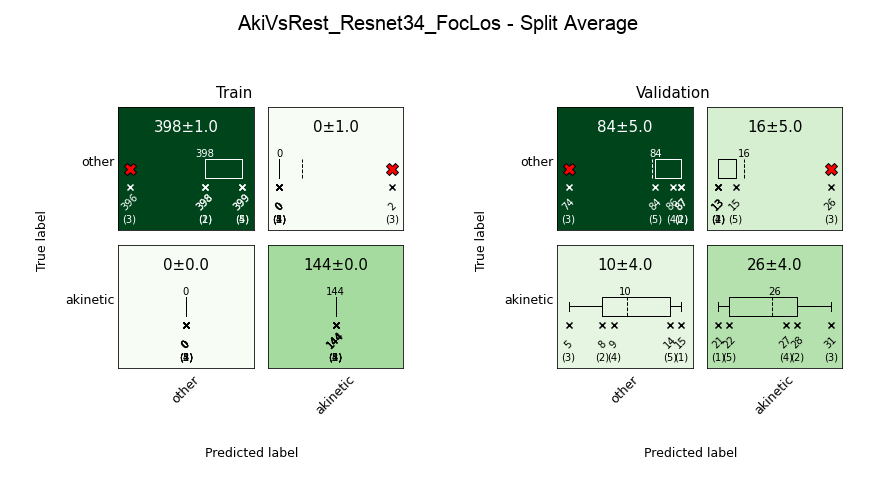



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.193 ± 0.061,0.86 ± 0.076,0.807 ± 0.033,0.003 ± 0.002,1.0 ± 0.0,0.999 ± 0.002,0.999 ± 0.003,0.661 ± 0.059,0.999 ± 0.001,0.864 ± 0.027





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,other,Sacco,398,100
1,akinetic,Sacco,144,36


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2ac4738f40>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2a81ab3f40>'
FocalLoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.208# 0.511  0.735  | 0.282* 0.511  0.522  |   6.92
                    |                      | 0.204# 0.

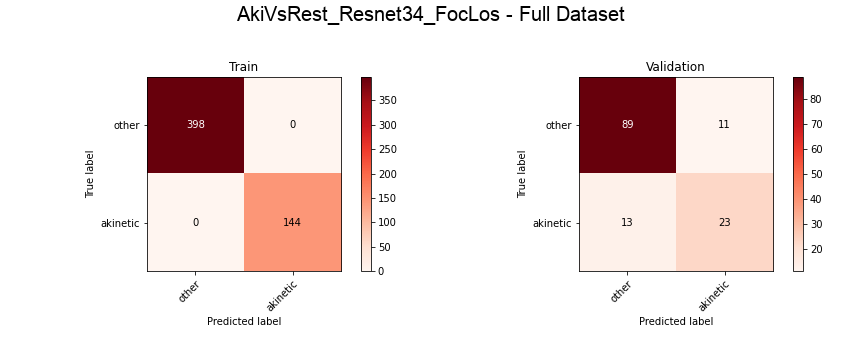

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
other                1      1      1.0     398       0.87   0.89     0.88   
akinetic             1      1      1.0     144       0.68   0.64     0.66   
accuracy                           1.0     542                       0.82   
macro avg            1      1      1.0     542       0.77   0.76     0.77   
weighted avg         1      1      1.0     542       0.82   0.82     0.82   

                      
             support  
other            100  
akinetic          36  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.193 ± 0.061,0.86 ± 0.076,0.807 ± 0.033,0.003 ± 0.002,1.0 ± 0.0,0.999 ± 0.002,0.999 ± 0.003,0.661 ± 0.059,0.999 ± 0.001,0.864 ± 0.027
Full,0.188,0.836,0.824,0.001,1,1,1,0.657,1,0.881


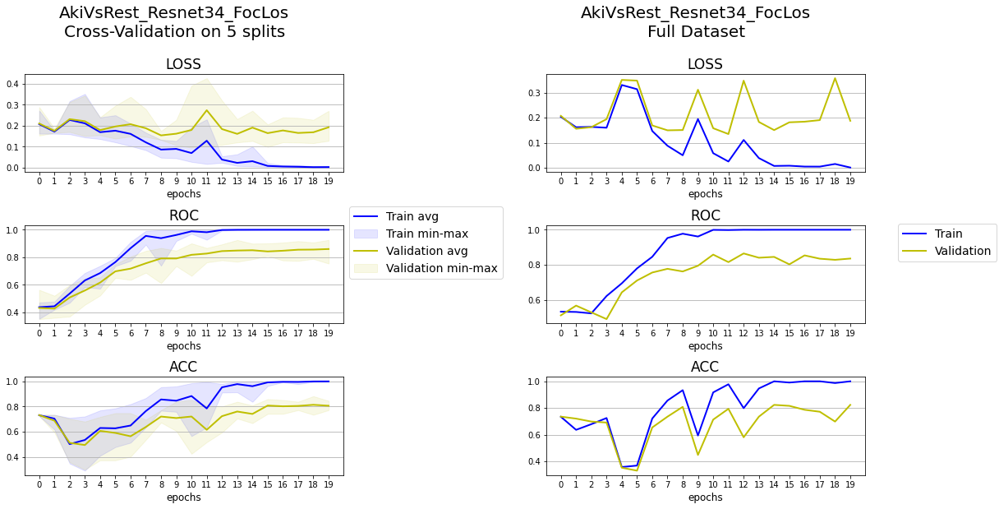

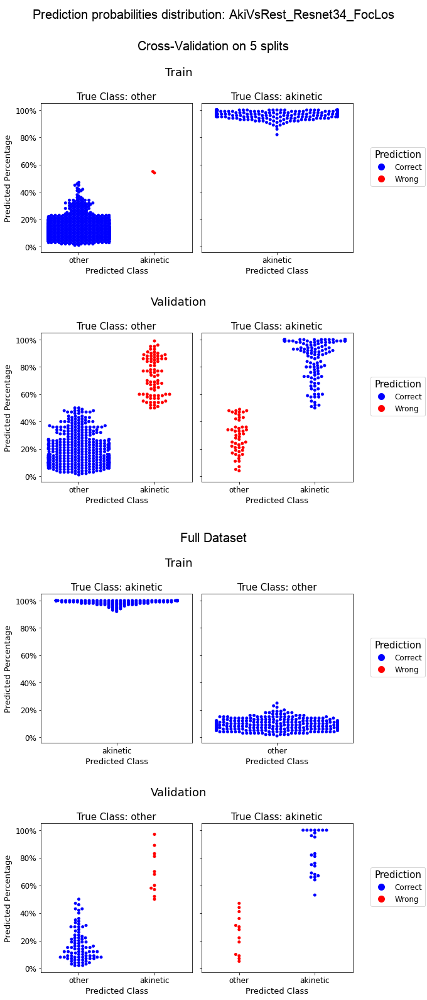



============================== FocLos - InvertClass:yes ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,other,Sacco,398,398,398,399,399



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,other,Sacco,100,100,100,99,99



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a883865e0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.354# 0.503  0.279  | 0.268* 0.524  0.506  |   6.86
                    |                      | 0.348# 0.543  0.266  |   6.86
0.010000   18   2.0 | 0.437# 0.522  0.272  | 0.236* 0.602  0.574  |  13.64
                    |                      | 0.466# 0.495  0.268  |  13.64
0.009000   27   3.0 | 0.543# 0.516  0.272  | 0.193* 0.728  0.637  |  20.47
       

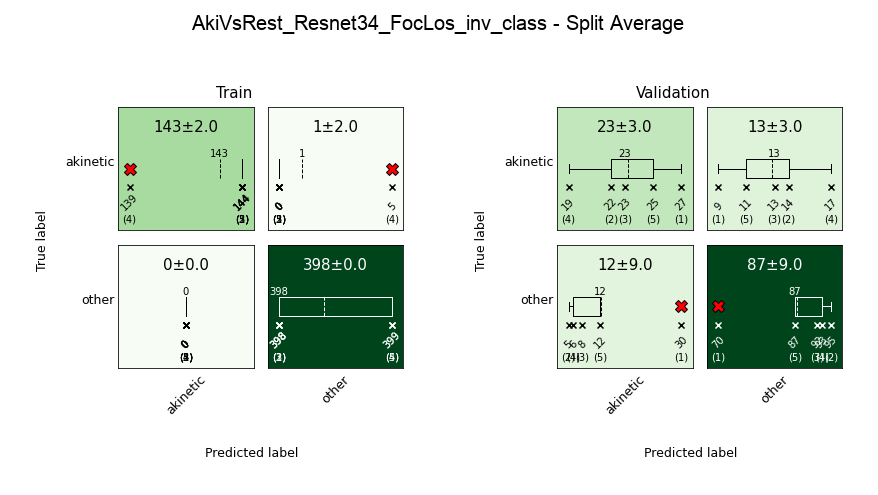



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.201 ± 0.101,0.865 ± 0.036,0.816 ± 0.059,0.002 ± 0.002,1.0 ± 0.0,0.998 ± 0.004,0.996 ± 0.008,0.655 ± 0.051,0.999 ± 0.003,0.872 ± 0.051





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,other,Sacco,398,100


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a883865e0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2a80cbe1f0>'
FocalLoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.498# 0.474  0.272  | 0.253* 0.549  0.533  |   6.89
                    |                      | 0.470# 0.

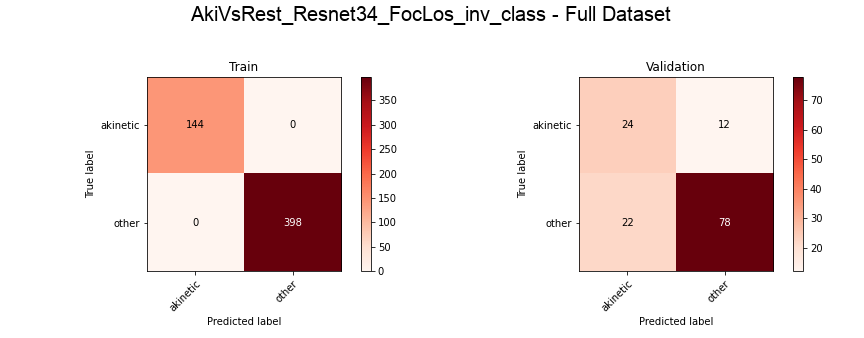

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1      1      1.0     144       0.52   0.67     0.59   
other                1      1      1.0     398       0.87   0.78     0.82   
accuracy                           1.0     542                       0.75   
macro avg            1      1      1.0     542       0.69   0.72     0.70   
weighted avg         1      1      1.0     542       0.78   0.75     0.76   

                      
             support  
akinetic          36  
other            100  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.201 ± 0.101,0.865 ± 0.036,0.816 ± 0.059,0.002 ± 0.002,1.0 ± 0.0,0.998 ± 0.004,0.996 ± 0.008,0.655 ± 0.051,0.999 ± 0.003,0.872 ± 0.051
Full,0.263,0.837,0.75,0.002,1,1,1,0.585,1,0.821


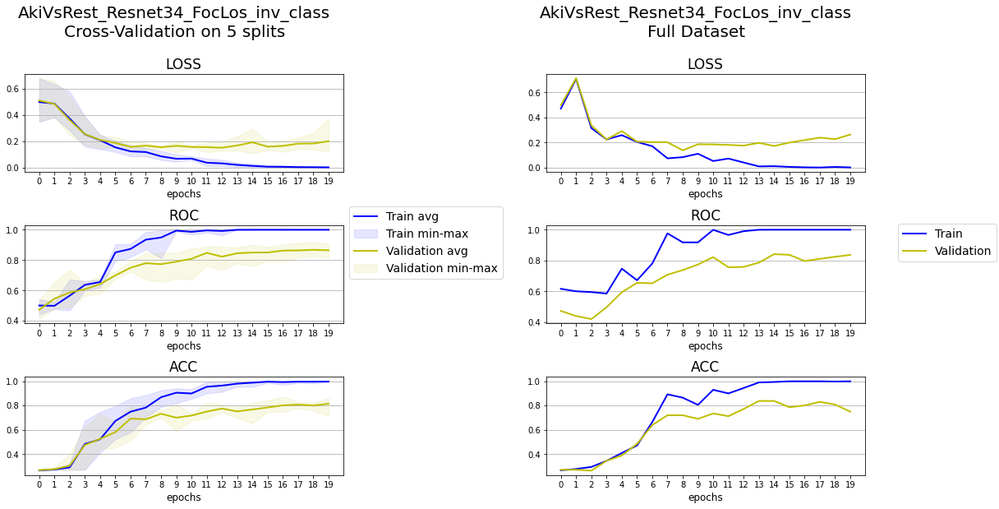

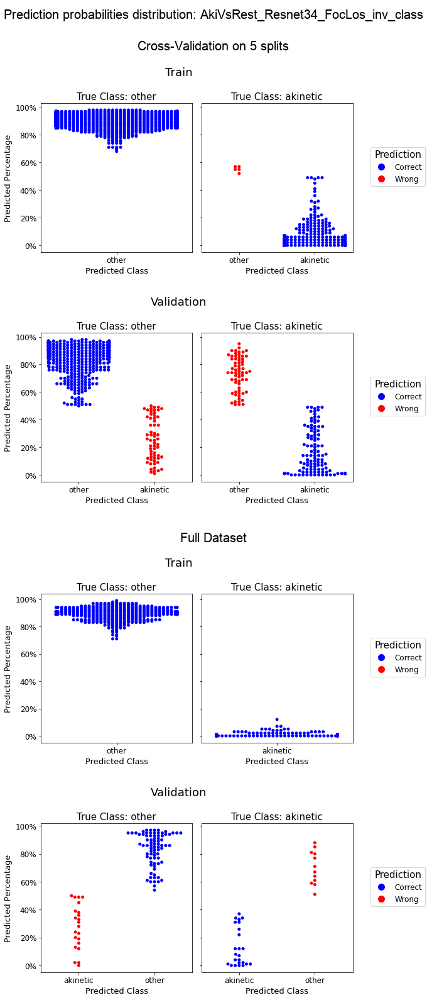




Final Log:


,session_ID,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score,loss,inverted_class,model_ID
Cross-Validation,AkiVsRest_Resnet34_BCE,0.638 ± 0.121,0.855 ± 0.019,0.811 ± 0.044,0.003 ± 0.001,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.603 ± 0.047,1.0 ± 0.0,0.875 ± 0.036,BCE,no,Resnet34
Full,AkiVsRest_Resnet34_BCE,0.593,0.879,0.831,0.002,1,1,1,0.657,1,0.888,BCE,no,Resnet34
Cross-Validation,AkiVsRest_Resnet34_BCE_inv_class,0.674 ± 0.111,0.845 ± 0.056,0.814 ± 0.043,0.002 ± 0.001,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.608 ± 0.108,1.0 ± 0.0,0.878 ± 0.028,BCE,yes,Resnet34
Full,AkiVsRest_Resnet34_BCE_inv_class,0.572,0.86,0.809,0.007,1,1,1,0.667,1,0.866,BCE,yes,Resnet34
Cross-Validation,AkiVsRest_Resnet34_FocLos,0.193 ± 0.061,0.86 ± 0.076,0.807 ± 0.033,0.003 ± 0.002,1.0 ± 0.0,0.999 ± 0.002,0.999 ± 0.003,0.661 ± 0.059,0.999 ± 0.001,0.864 ± 0.027,FocLos,no,Resnet34
Full,AkiVsRest_Resnet34_FocLos,0.188,0.836,0.824,0.001,1,1,1,0.657,1,0.881,FocLos,no,Resnet34
Cross-Validation,AkiVsRest_Resnet34_FocLos_inv_class,0.201 ± 0.101,0.865 ± 0.036,0.816 ± 0.059,0.002 ± 0.002,1.0 ± 0.0,0.998 ± 0.004,0.996 ± 0.008,0.655 ± 0.051,0.999 ± 0.003,0.872 ± 0.051,FocLos,yes,Resnet34
Full,AkiVsRest_Resnet34_FocLos_inv_class,0.263,0.837,0.75,0.002,1,1,1,0.585,1,0.821,FocLos,yes,Resnet34


In [5]:
# cross-validate and train model on full set - hyperparameter tuning for loss_set and invert_class_set

trainer_ID = 'AkiVsRest'
base_classifier_ID = Resnet34(num_channels=49)
dataset = dataset


cvu.tune_with_CV(trainer_ID = trainer_ID,
                 dataset = dataset,
                 base_classifier_ID = base_classifier_ID,
                 batch_size = batch_size,
                 n_splits = 5,
                 max_epochs_split = 20,
                 max_epochs_full = 20,
                 stratify_lab = dataset.labels,
                 loss_set = ['BCE', 'FocLos'],
                 invert_class_set = True,
                 measure_to_plot = ['loss', 'roc', 'acc'],
                 metrics = [Accuracy(), roc_auc_score],
                 show_info=False, show_log=2, show_perf_plot=True,
                 save_split_checkpoint=False, save_split_final=True,
                 save_full_checkpoint=False, save_full_final=True,
                 reload_split=False, reload_full=False)

# reload final performance log
final_log=pd.read_csv(os.path.join('results', trainer_ID, trainer_ID+'_final_performance.csv'), sep=';', index_col=0)

Evaluating heatmap:

 -- Gradient aggregation: mean
 -- Soft activation is applied to <class 'torch.nn.modules.activation.ReLU'> , replaced with LeakyReLU(negative_slope=0.01, inplace=True)

Processing 7/7 batch - Total elapsed time: 0:00:41
Done




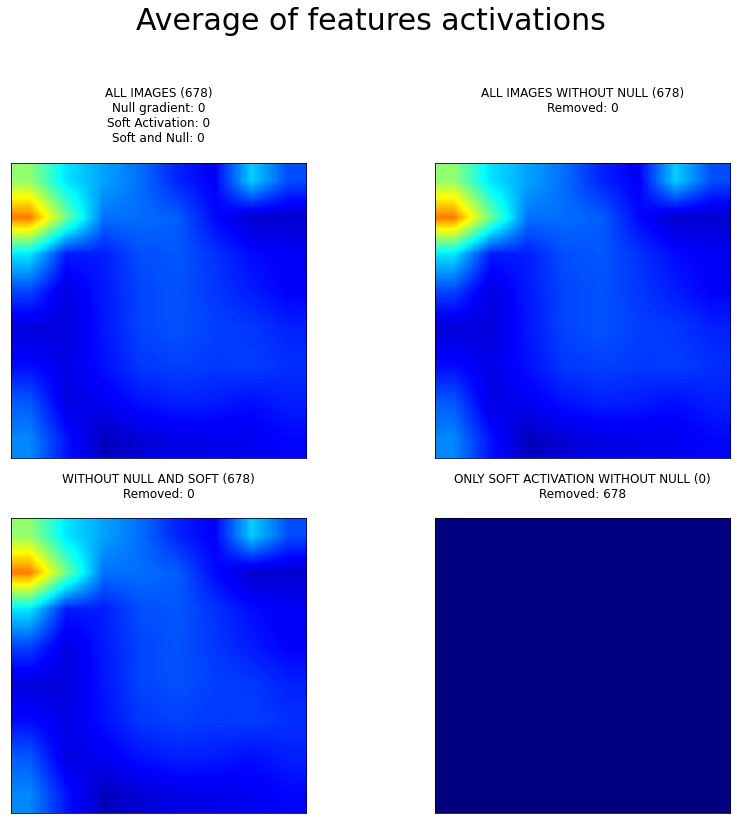

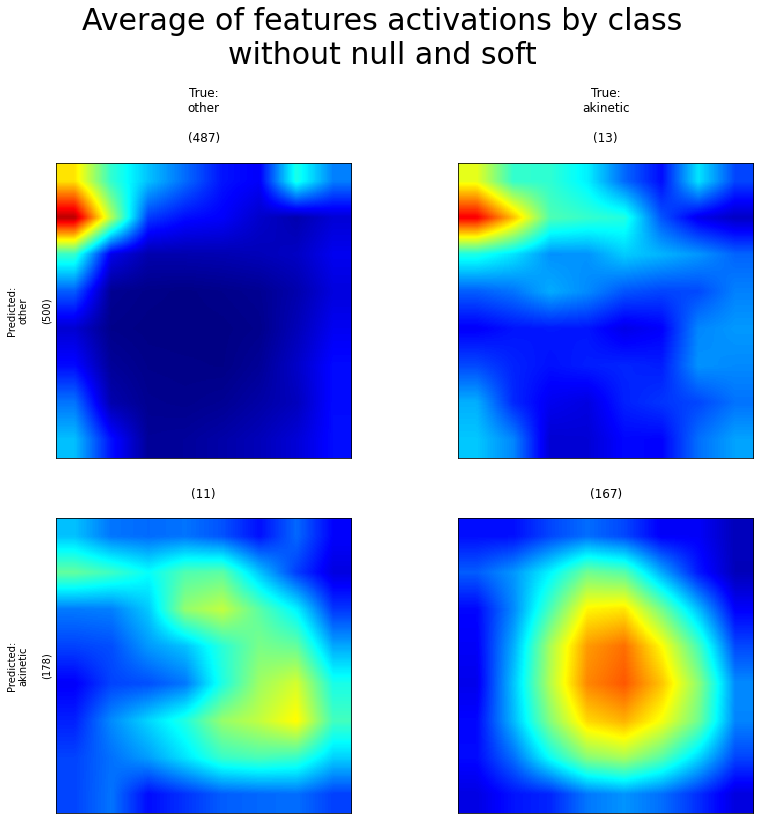

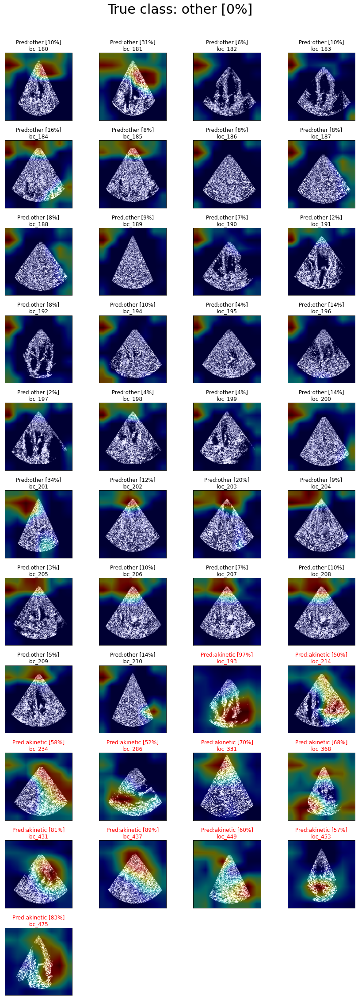

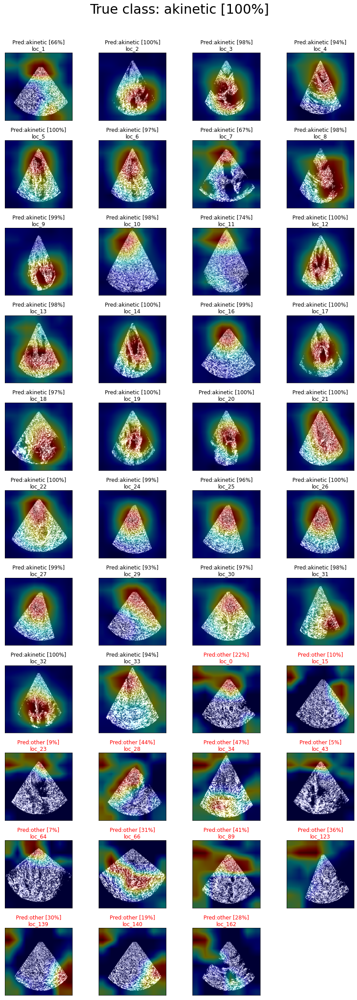

In [6]:
# evaluate features visualization

new_index = np.array(dataset.df.index)
multi_class = False
model = Resnet34FeatVis(num_channels=49)
reload_model_ID = 'AkiVsRest_Resnet34_FocLos_full'
model_ID = 'AkiVsRest_Resnet34_FocLos'
save_path = 'AkiVsRest'

fvu = FeaturesVisualizationUtils(save_path=save_path,
                                 model_ID=model_ID,
                                 image_size = size)
fvu.run_features_visualization(dataset=dataset,
                               new_index=new_index,
                               model=model,
                               reload_model_ID=reload_model_ID,
                               multi_class=multi_class,
                               gradient_aggregation='mean',
                               apply_soft_activation=True,
                               nn_to_replace=nn.ReLU,
                               nn_replacement=nn.LeakyReLU(inplace=True),
                               frame_to_show=0)
fvu.plot_heatmap(fig_size = 12)
fvu.plot_sample_masked(fig_size = 12, max_sample_combination = 30, sample_ncol = 4)
fvu.plot_heatmap_max_distribution()

# Train Akinetic vs Healthy

In [7]:
input_name = 'eco_50_first_diff_samplFirst_mask_256'
size = 256

dataset = ecoSaccoDataset(input_name, diagnosis_class=None, diagnosis_to_keep=['akinetic', 'healthy'],
                          size=size, show_info=True)

ecoSaccoDataset initialized with size=256, augment=None
Dataset is located in ./input/eco_50_first_diff_samplFirst_mask_256

############    eco_50_first_diff_samplFirst_mask_256 dataset    ############

Total files: 528
Total frames: 49


,image,label,meaning,source
0,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
1,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
2,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
3,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
4,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
...,...,...,...,...
523,./input/eco_50_first_diff_samplFirst_mask_256/...,1,healthy,Sacco
524,./input/eco_50_first_diff_samplFirst_mask_256/...,1,healthy,Sacco
525,./input/eco_50_first_diff_samplFirst_mask_256/...,1,healthy,Sacco
526,./input/eco_50_first_diff_samplFirst_mask_256/...,1,healthy,Sacco


,,,count
label,meaning,source,
0,akinetic,Sacco,180
1,healthy,Sacco,348



Used raw classifier: Resnet34

Start hyperparameter tuning


============================== BCE - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,healthy,Sacco,278,278,278,279,279



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,healthy,Sacco,70,70,70,69,69



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2ae6deab20>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 1.032# 0.433  0.340  | 0.775* 0.515  0.505  |   5.56
                    |                      | 1.016# 0.492  0.344  |   5.56
0.010000   14   2.0 | 1.164# 0.579  0.340  | 0.708* 0.609  0.590  |  11.04
                    |                      | 1.181# 0.623  0.341  |  11.04
0.009000   21   3.0 | 0.782# 0.633  0.396  | 0.628* 0.725  0.656  |  16.55
       

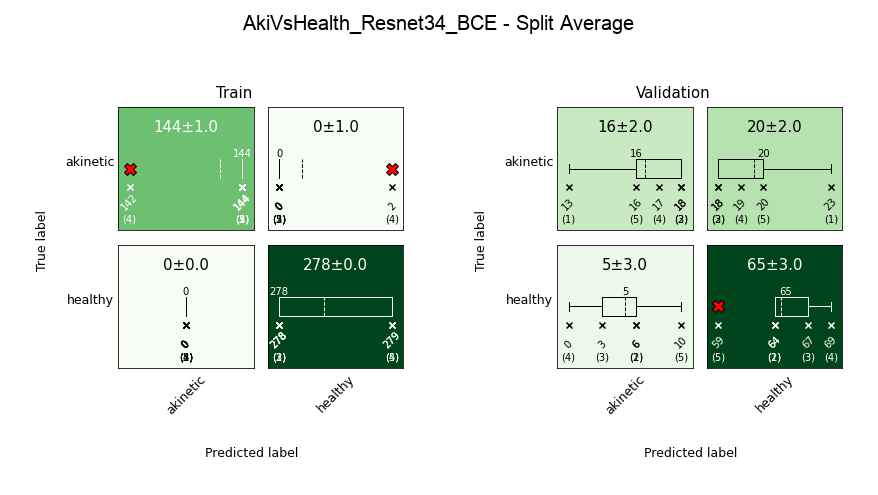



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_healthy_f1-score_Avg,valid_healthy_f1-score_Avg
0,0.754 ± 0.075,0.817 ± 0.03,0.767 ± 0.046,0.005 ± 0.008,1.0 ± 0.0,0.999 ± 0.002,0.999 ± 0.003,0.572 ± 0.074,0.999 ± 0.002,0.84 ± 0.034





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,healthy,Sacco,278,70


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2ae6deab20>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2b70d4fd00>'
BCELoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 1.246# 0.444  0.340  | 0.781* 0.490  0.505  |   5.53
                    |                      | 1.209# 0.54

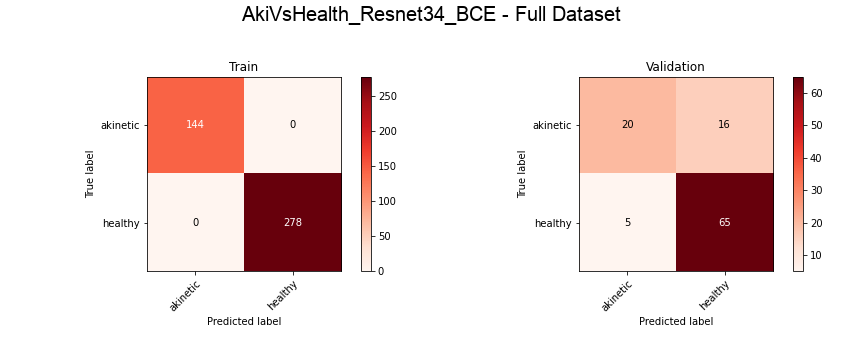

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1      1      1.0     144        0.8   0.56     0.66   
healthy              1      1      1.0     278        0.8   0.93     0.86   
accuracy                           1.0     422                       0.80   
macro avg            1      1      1.0     422        0.8   0.74     0.76   
weighted avg         1      1      1.0     422        0.8    0.8     0.79   

                      
             support  
akinetic          36  
healthy           70  
accuracy         106  
macro avg        106  
weighted avg     106


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_healthy_f1-score,valid_healthy_f1-score
Set,,,,,,,,,,
Cross-Validation,0.754 ± 0.075,0.817 ± 0.03,0.767 ± 0.046,0.005 ± 0.008,1.0 ± 0.0,0.999 ± 0.002,0.999 ± 0.003,0.572 ± 0.074,0.999 ± 0.002,0.84 ± 0.034
Full,0.56,0.859,0.802,0.001,1,1,1,0.656,1,0.861


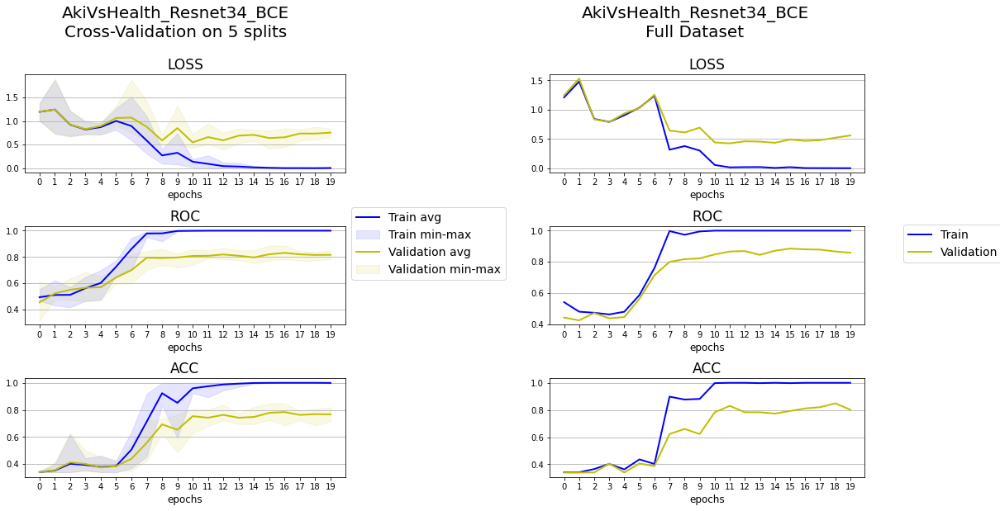

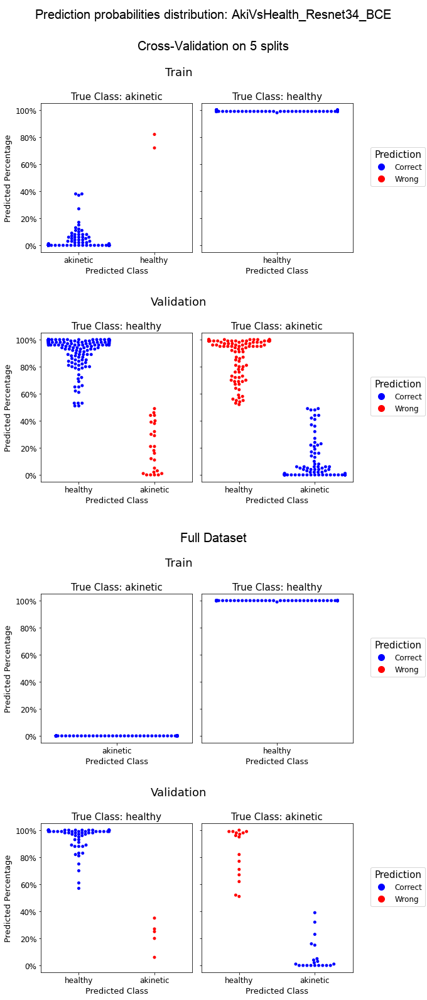



============================== BCE - InvertClass:yes ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,healthy,Sacco,278,278,278,279,279
1,akinetic,Sacco,144,144,144,144,144



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,healthy,Sacco,70,70,70,69,69
1,akinetic,Sacco,36,36,36,36,36



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a925577c0>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 0.707# 0.548  0.660  | 0.770* 0.483  0.486  |   5.48
                    |                      | 0.714# 0.562  0.659  |   5.48
0.010000   14   2.0 | 0.651# 0.540  0.660  | 0.699* 0.598  0.569  |  10.90
                    |                      | 0.652# 0.552  0.659  |  10.90
0.009000   21   3.0 | 0.615# 0.623  0.670  | 0.623* 0.720  0.661  |  16.38
       

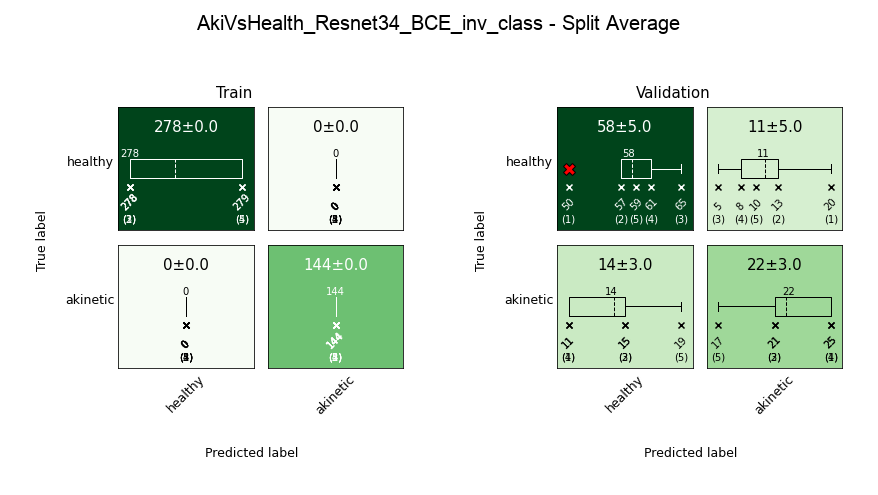



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_healthy_f1-score_Avg,valid_healthy_f1-score_Avg
0,0.754 ± 0.163,0.807 ± 0.052,0.76 ± 0.052,0.002 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.632 ± 0.071,1.0 ± 0.0,0.82 ± 0.045





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,healthy,Sacco,278,70
1,akinetic,Sacco,144,36


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a925577c0>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2a8077bf40>'
BCELoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 0.698# 0.419  0.660  | 0.734* 0.554  0.524  |   5.52
                    |                      | 0.693# 0.41

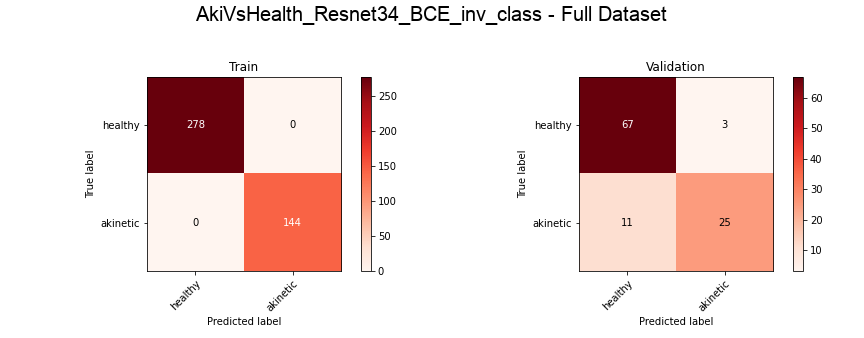

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
healthy              1      1      1.0     278       0.86   0.96     0.91   
akinetic             1      1      1.0     144       0.89   0.69     0.78   
accuracy                           1.0     422                       0.87   
macro avg            1      1      1.0     422       0.88   0.83     0.84   
weighted avg         1      1      1.0     422       0.87   0.87     0.86   

                      
             support  
healthy           70  
akinetic          36  
accuracy         106  
macro avg        106  
weighted avg     106


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_healthy_f1-score,valid_healthy_f1-score
Set,,,,,,,,,,
Cross-Validation,0.754 ± 0.163,0.807 ± 0.052,0.76 ± 0.052,0.002 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.632 ± 0.071,1.0 ± 0.0,0.82 ± 0.045
Full,0.326,0.927,0.868,0.002,1,1,1,0.781,1,0.905


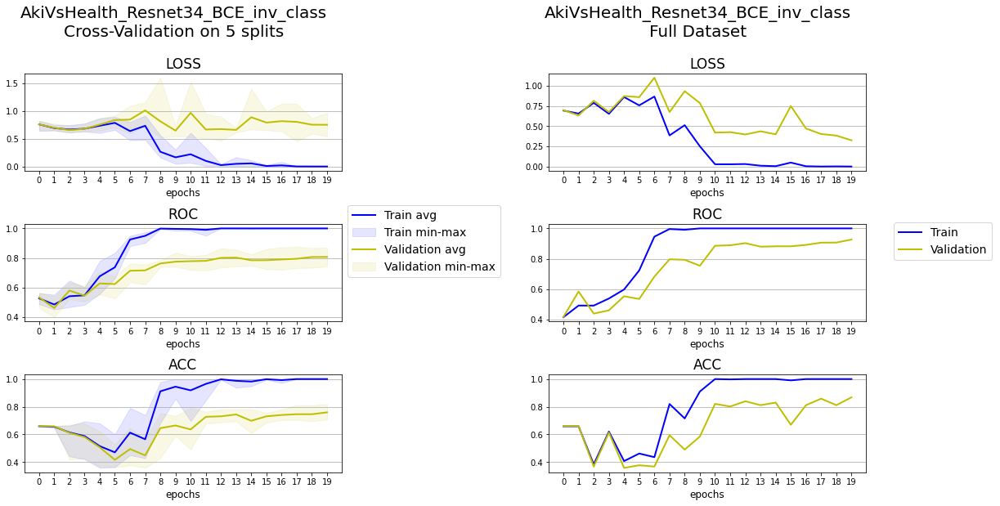

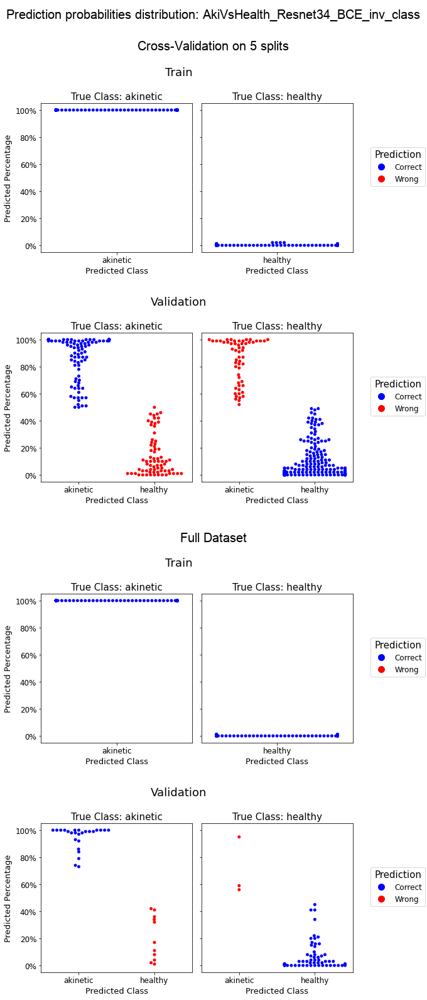



============================== FocLos - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,healthy,Sacco,278,278,278,279,279



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,healthy,Sacco,70,70,70,69,69



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a925d6eb0>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 0.740# 0.555  0.340  | 0.271* 0.533  0.509  |   5.46
                    |                      | 0.743# 0.519  0.341  |   5.46
0.010000   14   2.0 | 0.573# 0.510  0.340  | 0.239* 0.570  0.550  |  10.89
                    |                      | 0.581# 0.547  0.341  |  10.89
0.009000   21   3.0 | 0.456# 0.443  0.349  | 0.231* 0.612  0.559  |  16.37
       

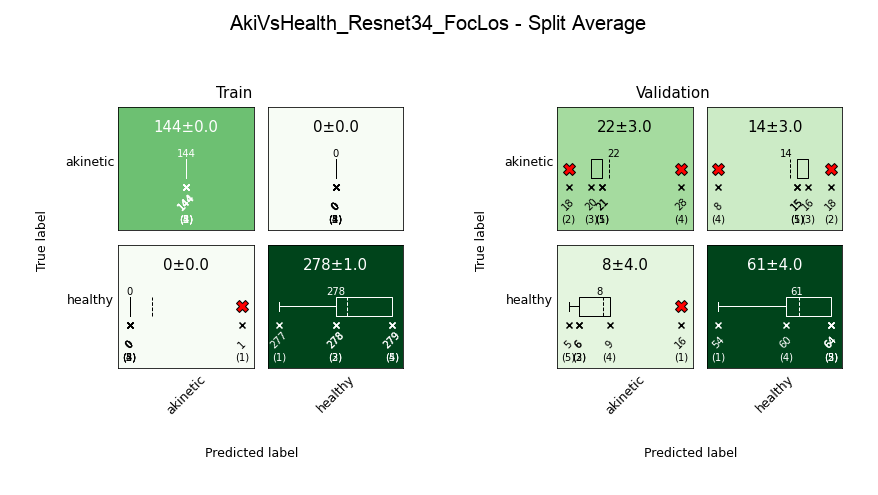



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_healthy_f1-score_Avg,valid_healthy_f1-score_Avg
0,0.194 ± 0.041,0.832 ± 0.054,0.784 ± 0.049,0.002 ± 0.004,1.0 ± 0.0,1.0 ± 0.001,0.999 ± 0.002,0.653 ± 0.075,1.0 ± 0.001,0.843 ± 0.039





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,healthy,Sacco,278,70


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a925d6eb0>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2a925de9a0>'
FocalLoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 0.264# 0.615  0.330  | 0.269* 0.521  0.502  |   5.52
                    |                      | 0.273# 0.

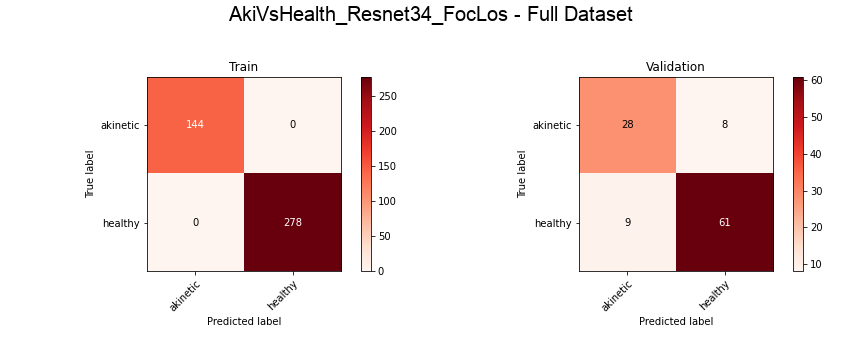

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1      1      1.0     144       0.76   0.78     0.77   
healthy              1      1      1.0     278       0.88   0.87     0.88   
accuracy                           1.0     422                       0.84   
macro avg            1      1      1.0     422       0.82   0.82     0.82   
weighted avg         1      1      1.0     422       0.84   0.84     0.84   

                      
             support  
akinetic          36  
healthy           70  
accuracy         106  
macro avg        106  
weighted avg     106


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_healthy_f1-score,valid_healthy_f1-score
Set,,,,,,,,,,
Cross-Validation,0.194 ± 0.041,0.832 ± 0.054,0.784 ± 0.049,0.002 ± 0.004,1.0 ± 0.0,1.0 ± 0.001,0.999 ± 0.002,0.653 ± 0.075,1.0 ± 0.001,0.843 ± 0.039
Full,0.138,0.9,0.84,0,1,1,1,0.767,1,0.878


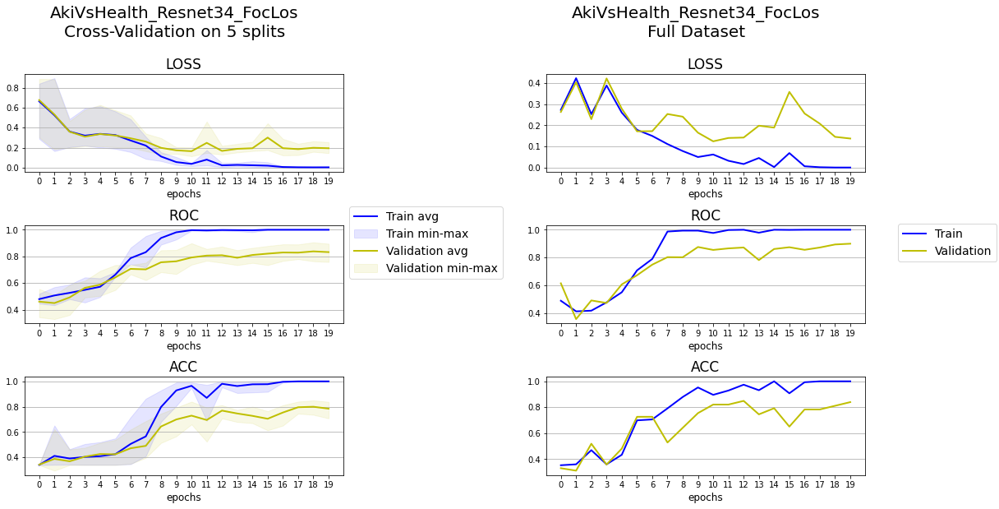

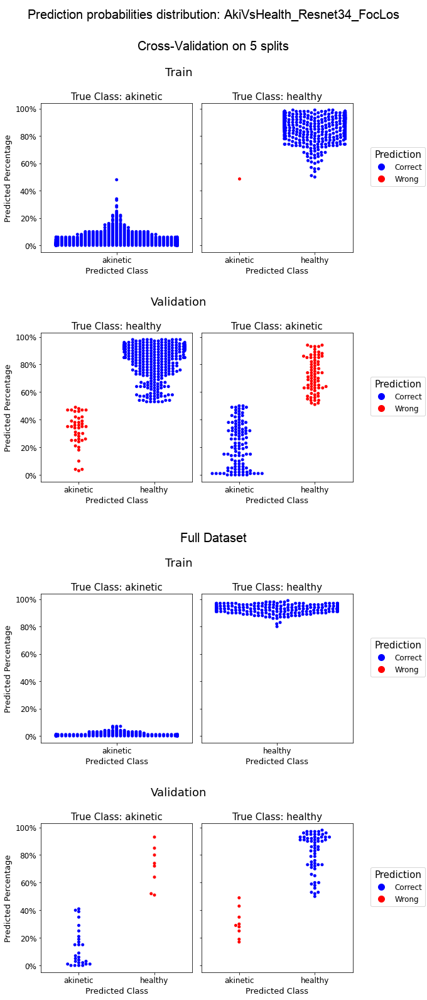



============================== FocLos - InvertClass:yes ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,healthy,Sacco,278,278,278,279,279
1,akinetic,Sacco,144,144,144,144,144



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,healthy,Sacco,70,70,70,69,69
1,akinetic,Sacco,36,36,36,36,36



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a80ff2b50>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 0.318# 0.513  0.660  | 0.260* 0.533  0.531  |   5.51
                    |                      | 0.324# 0.549  0.659  |   5.51
0.010000   14   2.0 | 0.182# 0.465  0.623  | 0.236* 0.598  0.566  |  10.97
                    |                      | 0.181# 0.479  0.614  |  10.97
0.009000   21   3.0 | 0.244# 0.542  0.358  | 0.237* 0.596  0.569  |  16.46
       

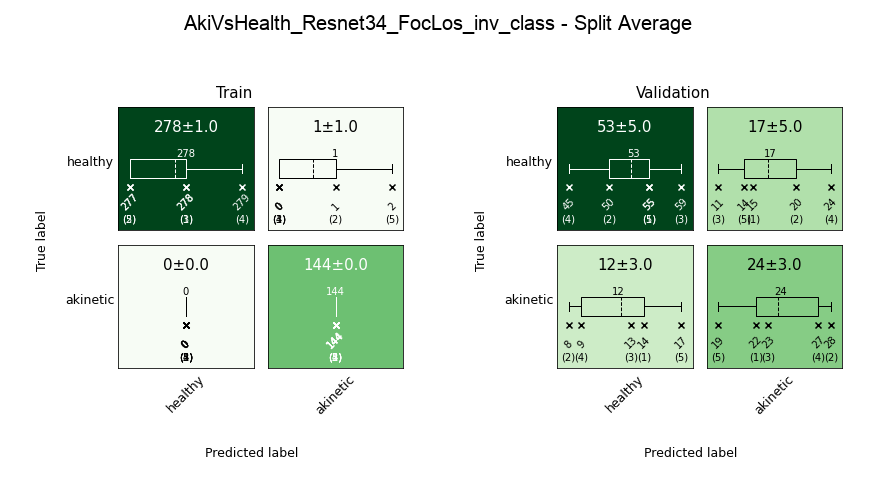



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_healthy_f1-score_Avg,valid_healthy_f1-score_Avg
0,0.22 ± 0.027,0.796 ± 0.059,0.725 ± 0.033,0.004 ± 0.002,1.0 ± 0.0,0.999 ± 0.002,0.998 ± 0.003,0.62 ± 0.047,0.999 ± 0.002,0.783 ± 0.035





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,healthy,Sacco,278,70
1,akinetic,Sacco,144,36


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a80ff2b50>
batch size: 64
Train set: 422
Validation set: 106
Training with 7 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 7 iter, saving checkpoints every 35 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2a800869d0>'
FocalLoss()'
[Accuracy(), <function roc_auc_score at 0x7f2ae7010040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    7   1.0 | 0.458# 0.489  0.660  | 0.285* 0.517  0.531  |   5.52
                    |                      | 0.460# 0.

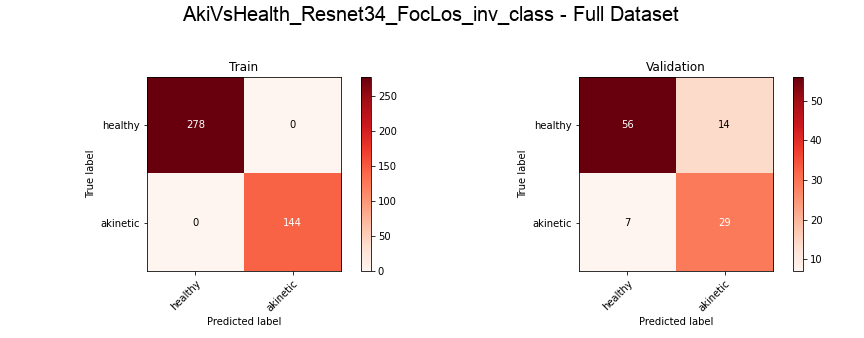

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
healthy              1      1      1.0     278       0.89    0.8     0.84   
akinetic             1      1      1.0     144       0.67   0.81     0.73   
accuracy                           1.0     422                       0.80   
macro avg            1      1      1.0     422       0.78    0.8     0.79   
weighted avg         1      1      1.0     422       0.82    0.8     0.81   

                      
             support  
healthy           70  
akinetic          36  
accuracy         106  
macro avg        106  
weighted avg     106


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_healthy_f1-score,valid_healthy_f1-score
Set,,,,,,,,,,
Cross-Validation,0.22 ± 0.027,0.796 ± 0.059,0.725 ± 0.033,0.004 ± 0.002,1.0 ± 0.0,0.999 ± 0.002,0.998 ± 0.003,0.62 ± 0.047,0.999 ± 0.002,0.783 ± 0.035
Full,0.198,0.833,0.802,0.001,1,1,1,0.734,1,0.842


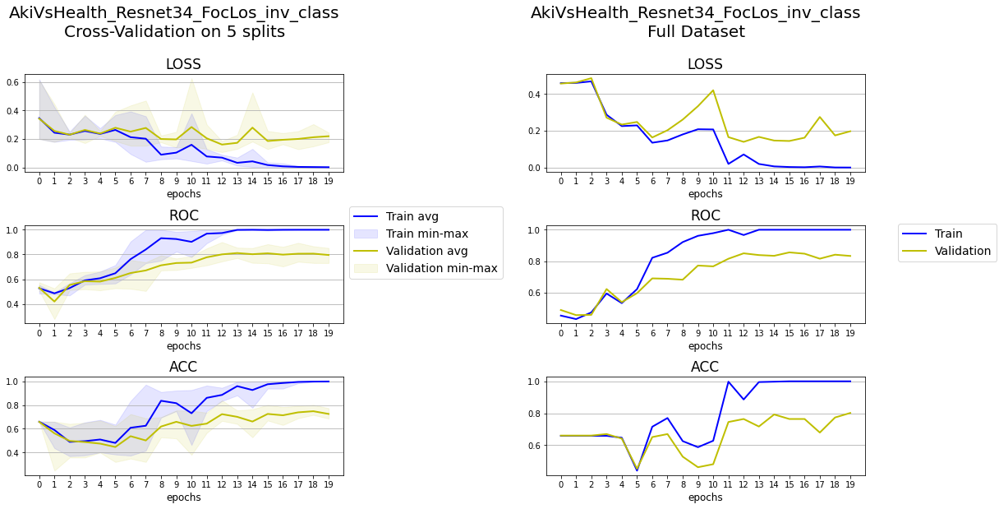

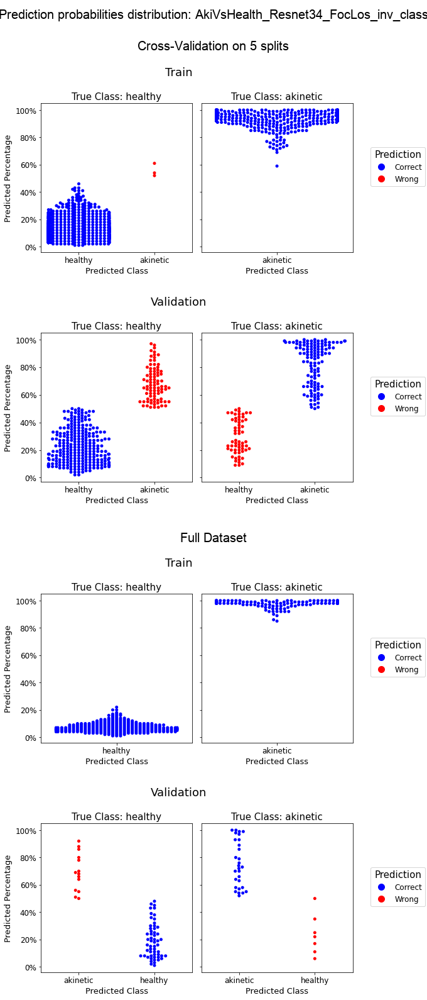




Final Log:


,session_ID,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_healthy_f1-score,valid_healthy_f1-score,loss,inverted_class,model_ID
Cross-Validation,AkiVsHealth_Resnet34_BCE,0.754 ± 0.075,0.817 ± 0.03,0.767 ± 0.046,0.005 ± 0.008,1.0 ± 0.0,0.999 ± 0.002,0.999 ± 0.003,0.572 ± 0.074,0.999 ± 0.002,0.84 ± 0.034,BCE,no,Resnet34
Full,AkiVsHealth_Resnet34_BCE,0.56,0.859,0.802,0.001,1,1,1,0.656,1,0.861,BCE,no,Resnet34
Cross-Validation,AkiVsHealth_Resnet34_BCE_inv_class,0.754 ± 0.163,0.807 ± 0.052,0.76 ± 0.052,0.002 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.632 ± 0.071,1.0 ± 0.0,0.82 ± 0.045,BCE,yes,Resnet34
Full,AkiVsHealth_Resnet34_BCE_inv_class,0.326,0.927,0.868,0.002,1,1,1,0.781,1,0.905,BCE,yes,Resnet34
Cross-Validation,AkiVsHealth_Resnet34_FocLos,0.194 ± 0.041,0.832 ± 0.054,0.784 ± 0.049,0.002 ± 0.004,1.0 ± 0.0,1.0 ± 0.001,0.999 ± 0.002,0.653 ± 0.075,1.0 ± 0.001,0.843 ± 0.039,FocLos,no,Resnet34
Full,AkiVsHealth_Resnet34_FocLos,0.138,0.9,0.84,0,1,1,1,0.767,1,0.878,FocLos,no,Resnet34
Cross-Validation,AkiVsHealth_Resnet34_FocLos_inv_class,0.22 ± 0.027,0.796 ± 0.059,0.725 ± 0.033,0.004 ± 0.002,1.0 ± 0.0,0.999 ± 0.002,0.998 ± 0.003,0.62 ± 0.047,0.999 ± 0.002,0.783 ± 0.035,FocLos,yes,Resnet34
Full,AkiVsHealth_Resnet34_FocLos_inv_class,0.198,0.833,0.802,0.001,1,1,1,0.734,1,0.842,FocLos,yes,Resnet34


In [8]:
# cross-validate and train model on full set - hyperparameter tuning for loss_set and invert_class_set

trainer_ID = 'AkiVsHealth'
base_classifier_ID = Resnet34(num_channels=49)
dataset = dataset


cvu.tune_with_CV(trainer_ID = trainer_ID,
                 dataset = dataset,
                 base_classifier_ID = base_classifier_ID,
                 batch_size = batch_size,
                 n_splits = 5,
                 max_epochs_split = 20,
                 max_epochs_full = 20,
                 stratify_lab = dataset.labels,
                 loss_set = ['BCE', 'FocLos'],
                 invert_class_set = True,
                 measure_to_plot = ['loss', 'roc', 'acc'],
                 metrics = [Accuracy(), roc_auc_score],
                 show_info=False, show_log=2, show_perf_plot=True,
                 save_split_checkpoint=False, save_split_final=True,
                 save_full_checkpoint=False, save_full_final=True,
                 reload_split=False, reload_full=False)

# reload final performance log
final_log=pd.read_csv(os.path.join('results', trainer_ID, trainer_ID+'_final_performance.csv'), sep=';', index_col=0)

Evaluating heatmap:

 -- Gradient aggregation: mean
 -- Soft activation is applied to <class 'torch.nn.modules.activation.ReLU'> , replaced with LeakyReLU(negative_slope=0.01, inplace=True)

Processing 6/6 batch - Total elapsed time: 0:00:31
Done




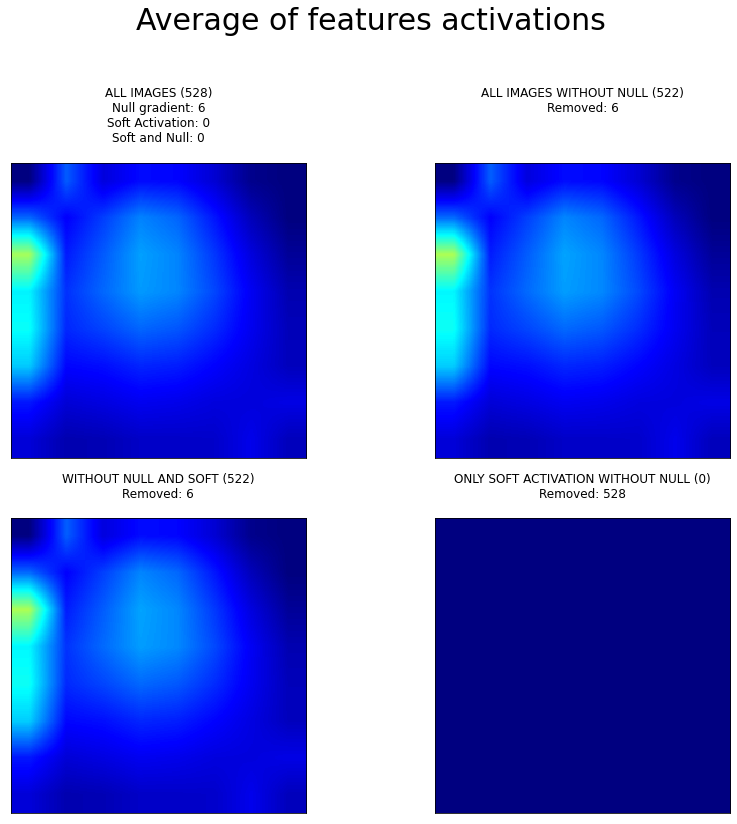

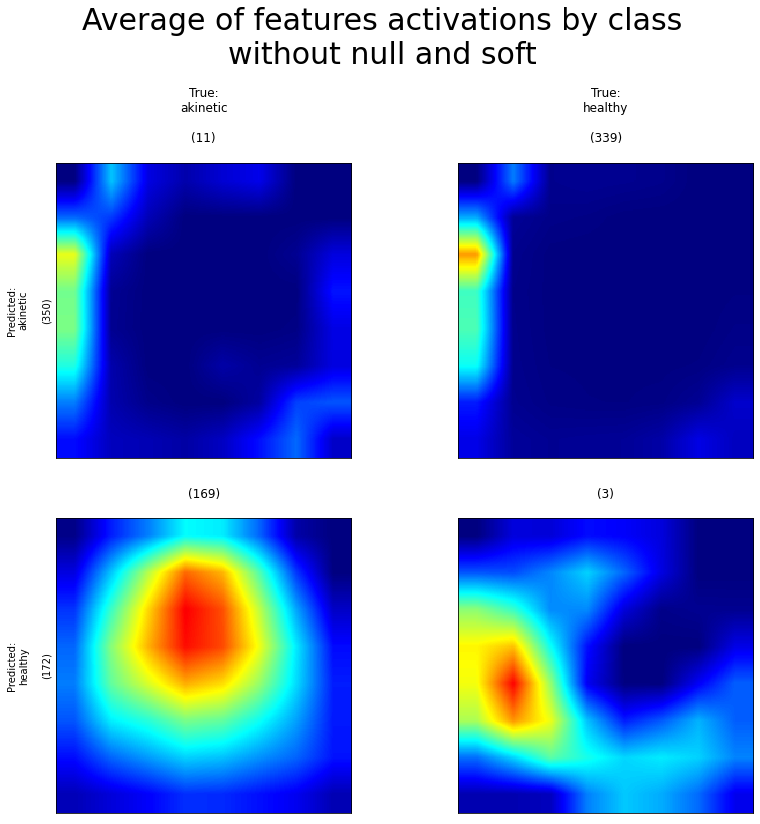

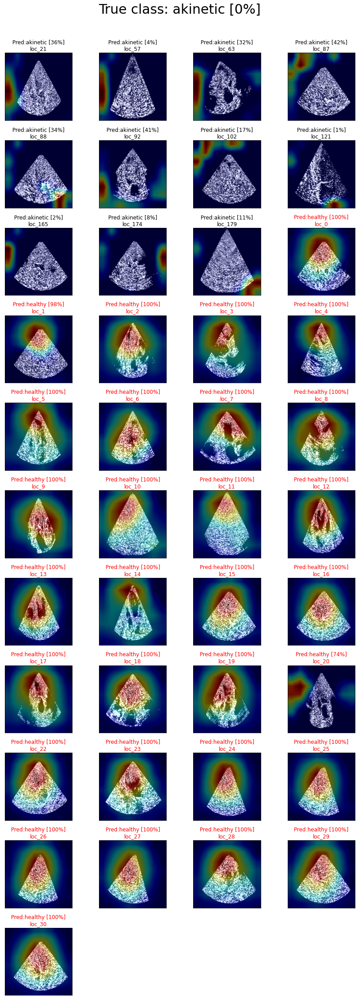

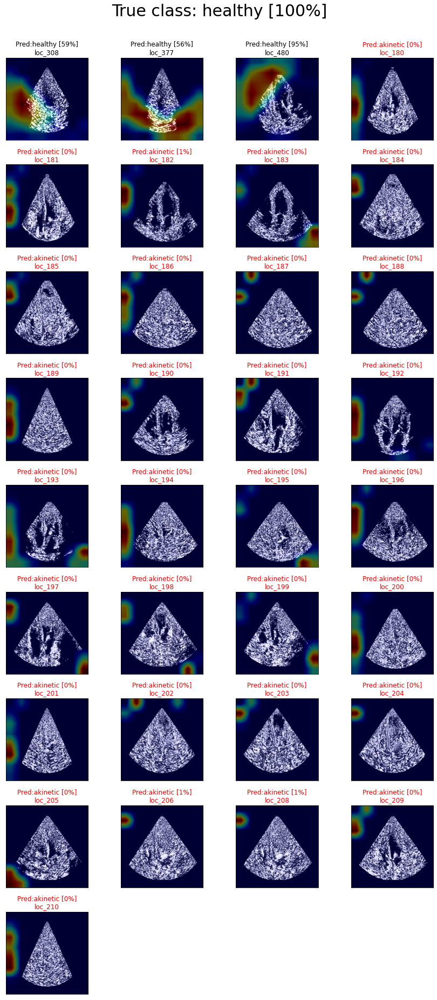

In [9]:
# evaluate features visualization

new_index = np.array(dataset.df.index)
multi_class = False
model = Resnet34FeatVis(num_channels=49)
reload_model_ID = 'AkiVsHealth_Resnet34_BCE_inv_class_full'
model_ID = 'AkiVsHealth_Resnet34_BCE_inv_class'
save_path = 'AkiVsHealth'

fvu = FeaturesVisualizationUtils(save_path=save_path,
                                 model_ID=model_ID,
                                 image_size = size)
fvu.run_features_visualization(dataset=dataset,
                               new_index=new_index,
                               model=model,
                               reload_model_ID=reload_model_ID,
                               multi_class=multi_class,
                               gradient_aggregation='mean',
                               apply_soft_activation=True,
                               nn_to_replace=nn.ReLU,
                               nn_replacement=nn.LeakyReLU(inplace=True),
                               frame_to_show=0)
fvu.plot_heatmap(fig_size = 12)
fvu.plot_sample_masked(fig_size = 12, max_sample_combination = 30, sample_ncol = 4)
fvu.plot_heatmap_max_distribution()

## Train multiclass model

In [10]:
input_name = 'eco_50_first_diff_samplFirst_mask_256'
size = 256

dataset = ecoSaccoDataset(input_name, diagnosis_class=None, diagnosis_to_keep=['akinetic', 'healthy', 'covid'],
                          size=size, show_info=True)

ecoSaccoDataset initialized with size=256, augment=None
Dataset is located in ./input/eco_50_first_diff_samplFirst_mask_256

############    eco_50_first_diff_samplFirst_mask_256 dataset    ############

Total files: 678
Total frames: 49


,image,label,meaning,source
0,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
1,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
2,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
3,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
4,./input/eco_50_first_diff_samplFirst_mask_256/...,0,akinetic,Sacco
...,...,...,...,...
673,./input/eco_50_first_diff_samplFirst_mask_256/...,2,covid,Sacco
674,./input/eco_50_first_diff_samplFirst_mask_256/...,2,covid,Sacco
675,./input/eco_50_first_diff_samplFirst_mask_256/...,2,covid,Sacco
676,./input/eco_50_first_diff_samplFirst_mask_256/...,2,covid,Sacco


,,,count
label,meaning,source,
0,akinetic,Sacco,180
1,healthy,Sacco,348
2,covid,Sacco,150



Used raw classifier: Resnet34

Start hyperparameter tuning


============================== NLL - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,healthy,Sacco,278,278,278,279,279
2,covid,Sacco,120,120,120,120,120



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,healthy,Sacco,70,70,70,69,69
2,covid,Sacco,30,30,30,30,30



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a814c5100>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 1.165# 0.375  0.250  | 1.241* 0.536  0.375  |   6.93
                    |                      | 1.144# 0.440  0.273  |   6.93
0.010000   18   2.0 | 1.254# 0.483  0.257  | 1.033* 0.688  0.472  |  13.81
                    |                      | 1.313# 0.400  0.201  |  13.81
0.009000   27   3.0 | 1.124# 0.547  0.368  | 0.858* 0.783  0.565  |  20.70
       

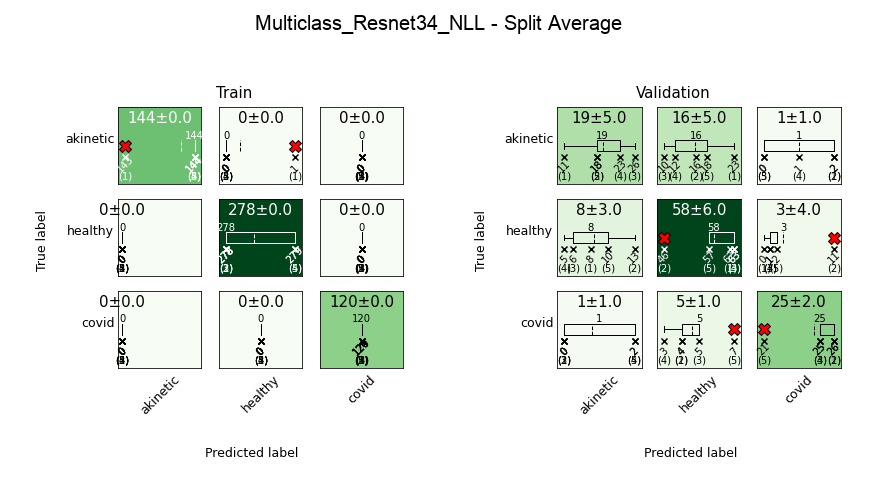



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_covid_f1-score_Avg,valid_covid_f1-score_Avg
0,0.771 ± 0.193,0.884 ± 0.033,0.752 ± 0.075,0.003 ± 0.003,1.0 ± 0.0,1.0 ± 0.001,0.999 ± 0.002,0.589 ± 0.144,1.0 ± 0.0,0.843 ± 0.065





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,healthy,Sacco,278,70
2,covid,Sacco,120,30


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a814c5100>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2a825dfa00>'
NLLLoss()'
[AccuracyMulti(), ROCMulti()]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 1.099# 0.457  0.404  | 1.261* 0.541  0.362  |   6.94
                    |                      | 1.084# 0.487  0.419  |   6.94
0.010000

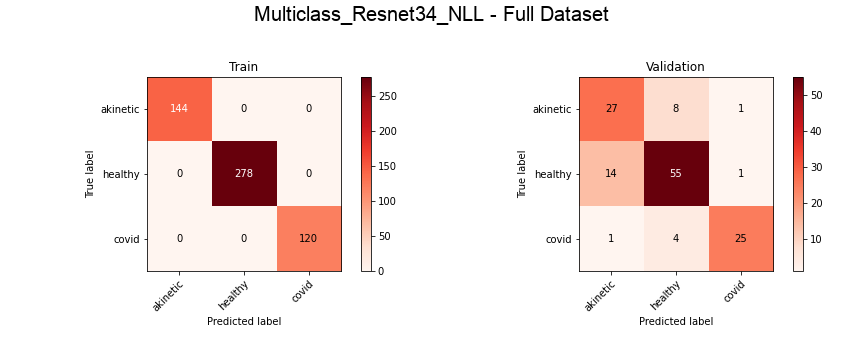

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1      1      1.0     144       0.64   0.75     0.69   
healthy              1      1      1.0     278       0.82   0.79     0.80   
covid                1      1      1.0     120       0.93   0.83     0.88   
accuracy                           1.0     542                       0.79   
macro avg            1      1      1.0     542        0.8   0.79     0.79   
weighted avg         1      1      1.0     542        0.8   0.79     0.79   

                      
             support  
akinetic          36  
healthy           70  
covid             30  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_covid_f1-score,valid_covid_f1-score
Set,,,,,,,,,,
Cross-Validation,0.771 ± 0.193,0.884 ± 0.033,0.752 ± 0.075,0.003 ± 0.003,1.0 ± 0.0,1.0 ± 0.001,0.999 ± 0.002,0.589 ± 0.144,1.0 ± 0.0,0.843 ± 0.065
Full,0.703,0.912,0.787,0.007,1,1,1,0.692,1,0.877


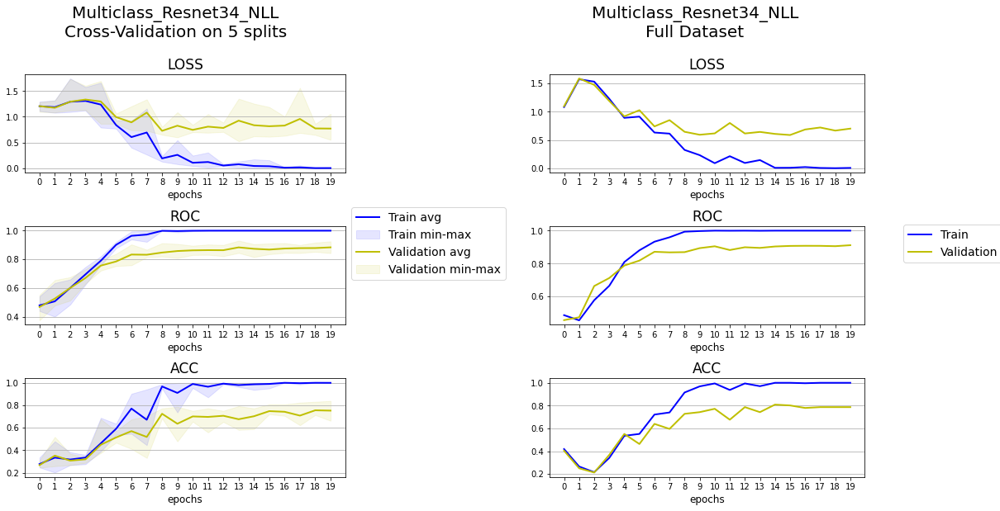

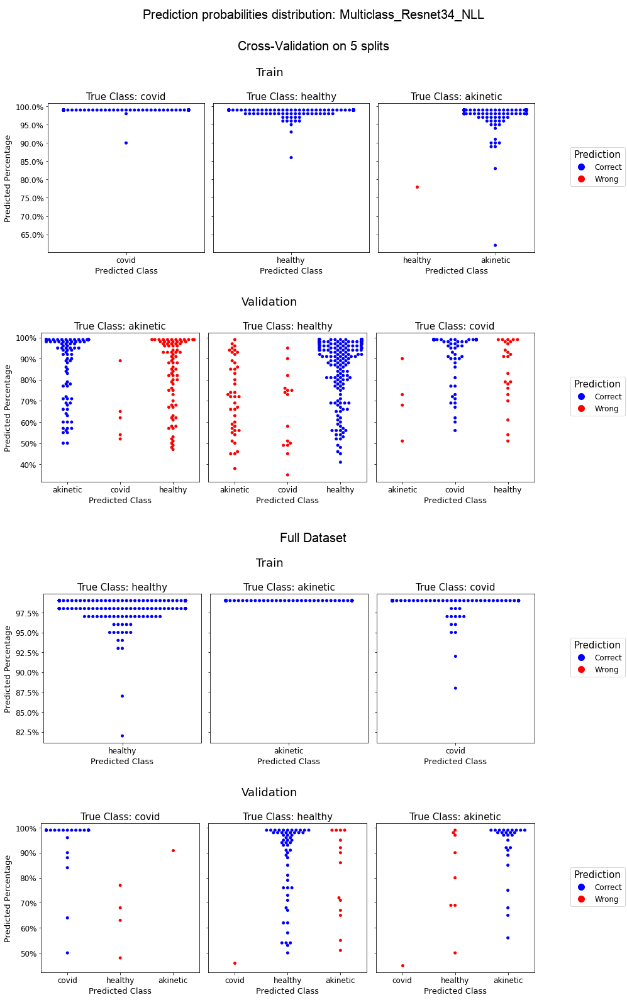



============================== FocLos - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,healthy,Sacco,278,278,278,279,279
2,covid,Sacco,120,120,120,120,120



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,healthy,Sacco,70,70,70,69,69
2,covid,Sacco,30,30,30,30,30



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a825df5e0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.479# 0.503  0.463  | 0.699* 0.572  0.354  |   6.91
                    |                      | 0.499# 0.443  0.424  |   6.91
0.010000   18   2.0 | 0.480# 0.596  0.426  | 0.599* 0.628  0.441  |  13.78
                    |                      | 0.488# 0.571  0.399  |  13.78
0.009000   27   3.0 | 0.762# 0.581  0.265  | 0.503* 0.723  0.511  |  20.64
       

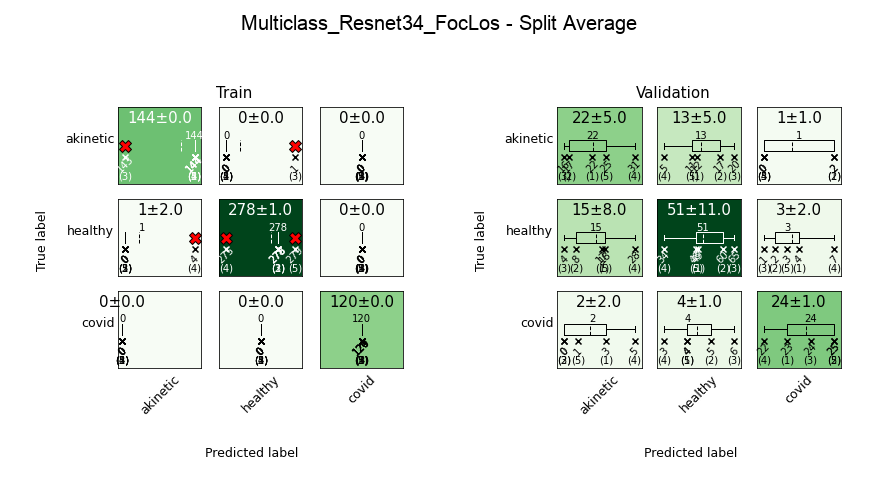



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_covid_f1-score_Avg,valid_covid_f1-score_Avg
0,0.398 ± 0.044,0.871 ± 0.019,0.717 ± 0.05,0.004 ± 0.005,1.0 ± 0.0,0.998 ± 0.003,0.997 ± 0.006,0.588 ± 0.032,1.0 ± 0.0,0.822 ± 0.056





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,healthy,Sacco,278,70
2,covid,Sacco,120,30


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7f2a825df5e0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7f2ac45b1970>'
FocalLoss()'
[AccuracyMulti(), ROCMulti()]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.523# 0.580  0.301  | 0.745* 0.517  0.345  |   6.96
                    |                      | 0.550# 0.491  0.275  |   6.96
0.0100

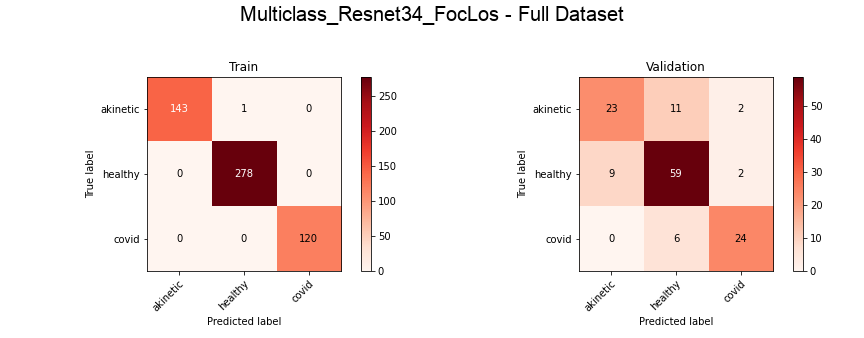

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1   0.99      1.0     144       0.72   0.64     0.68   
healthy              1      1      1.0     278       0.78   0.84     0.81   
covid                1      1      1.0     120       0.86    0.8     0.83   
accuracy                           1.0     542                       0.78   
macro avg            1      1      1.0     542       0.78   0.76     0.77   
weighted avg         1      1      1.0     542       0.78   0.78     0.78   

                      
             support  
akinetic          36  
healthy           70  
covid             30  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_covid_f1-score,valid_covid_f1-score
Set,,,,,,,,,,
Cross-Validation,0.398 ± 0.044,0.871 ± 0.019,0.717 ± 0.05,0.004 ± 0.005,1.0 ± 0.0,0.998 ± 0.003,0.997 ± 0.006,0.588 ± 0.032,1.0 ± 0.0,0.822 ± 0.056
Full,0.32,0.896,0.779,0.005,1,0.998,0.997,0.676,1,0.828


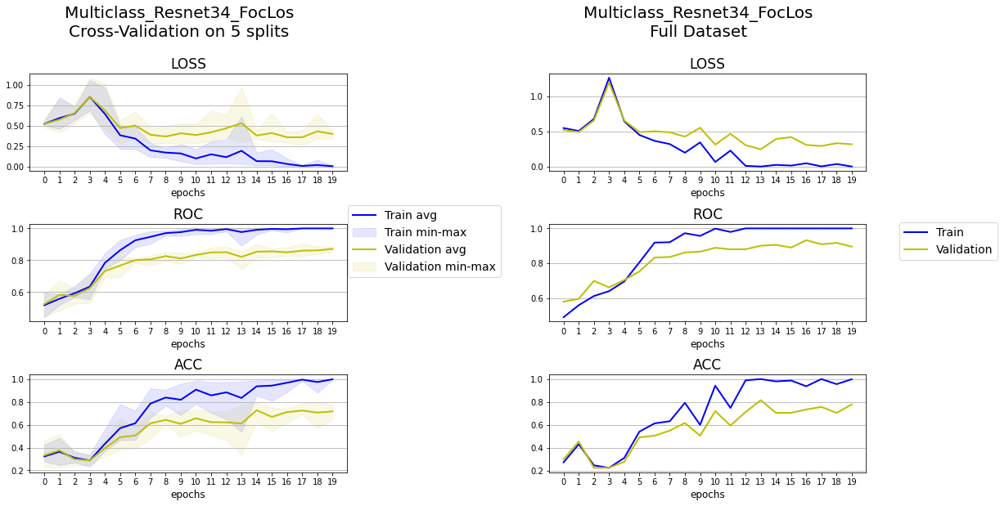

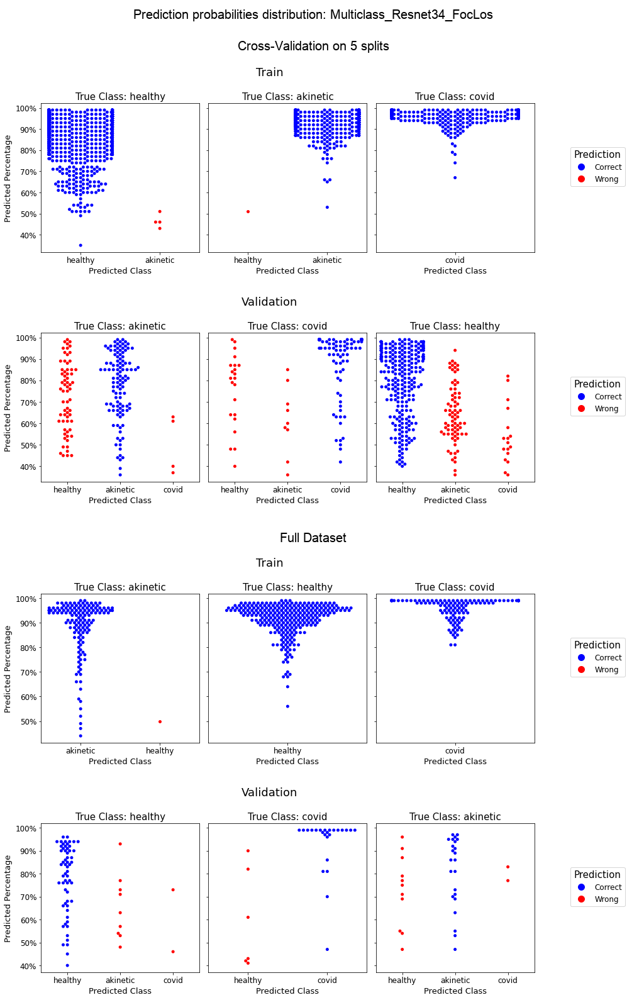




Final Log:


,session_ID,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_covid_f1-score,valid_covid_f1-score,loss,inverted_class,model_ID
Cross-Validation,Multiclass_Resnet34_NLL,0.771 ± 0.193,0.884 ± 0.033,0.752 ± 0.075,0.003 ± 0.003,1.0 ± 0.0,1.0 ± 0.001,0.999 ± 0.002,0.589 ± 0.144,1.0 ± 0.0,0.843 ± 0.065,NLL,no,Resnet34
Full,Multiclass_Resnet34_NLL,0.703,0.912,0.787,0.007,1,1,1,0.692,1,0.877,NLL,no,Resnet34
Cross-Validation,Multiclass_Resnet34_FocLos,0.398 ± 0.044,0.871 ± 0.019,0.717 ± 0.05,0.004 ± 0.005,1.0 ± 0.0,0.998 ± 0.003,0.997 ± 0.006,0.588 ± 0.032,1.0 ± 0.0,0.822 ± 0.056,FocLos,no,Resnet34
Full,Multiclass_Resnet34_FocLos,0.32,0.896,0.779,0.005,1,0.998,0.997,0.676,1,0.828,FocLos,no,Resnet34


In [11]:
# cross-validate and train model on full set - hyperparameter tuning for loss_set and invert_class_set

trainer_ID = 'Multiclass'
base_classifier_ID = Resnet34(num_channels=49, num_classes=3)
dataset = dataset


cvu.tune_with_CV(trainer_ID = trainer_ID,
                 dataset = dataset,
                 base_classifier_ID = base_classifier_ID,
                 batch_size = batch_size,
                 n_splits = 5,
                 max_epochs_split = 20,
                 max_epochs_full = 20,
                 stratify_lab = dataset.labels,
                 loss_set = ['NLL', 'FocLos'],
                 multi_class=True,
                 invert_class_set = True,
                 measure_to_plot = ['loss', 'roc', 'acc'],
                 metrics = [AccuracyMulti(ordered_class_labels=sorted(dataset.df.label.unique())), ROCMulti()],
                 show_info=False, show_log=2, show_perf_plot=True,
                 save_split_checkpoint=False, save_split_final=True,
                 save_full_checkpoint=False, save_full_final=True,
                 reload_split=False, reload_full=False)

# reload final performance log
final_log=pd.read_csv(os.path.join('results', trainer_ID, trainer_ID+'_final_performance.csv'), sep=';', index_col=0)

Evaluating heatmap:

 -- Gradient aggregation: mean
 -- Soft activation is applied to <class 'torch.nn.modules.activation.ReLU'> , replaced with LeakyReLU(negative_slope=0.01, inplace=True)

Processing 7/7 batch - Total elapsed time: 0:00:42
Done




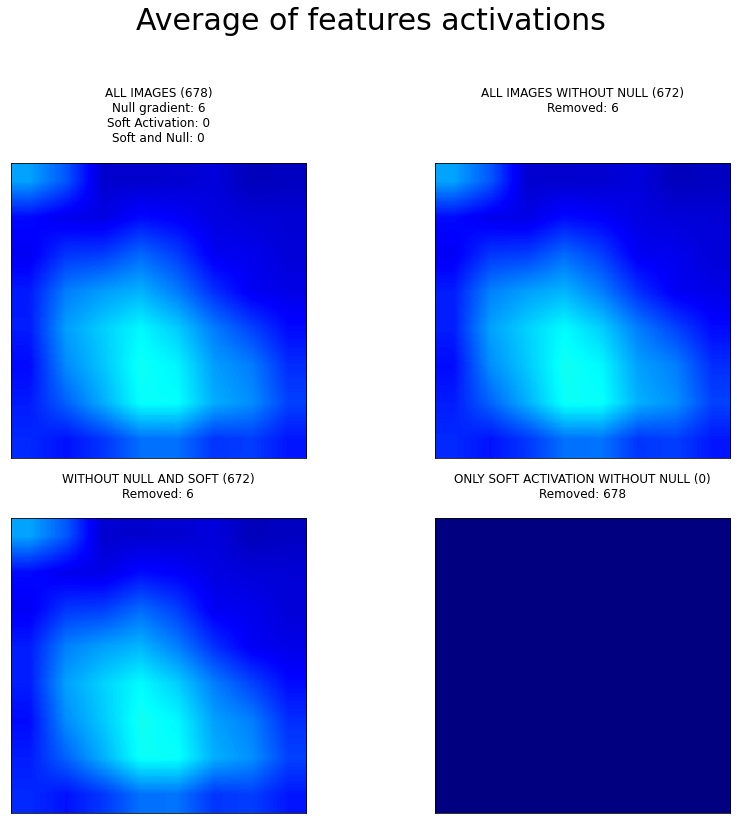

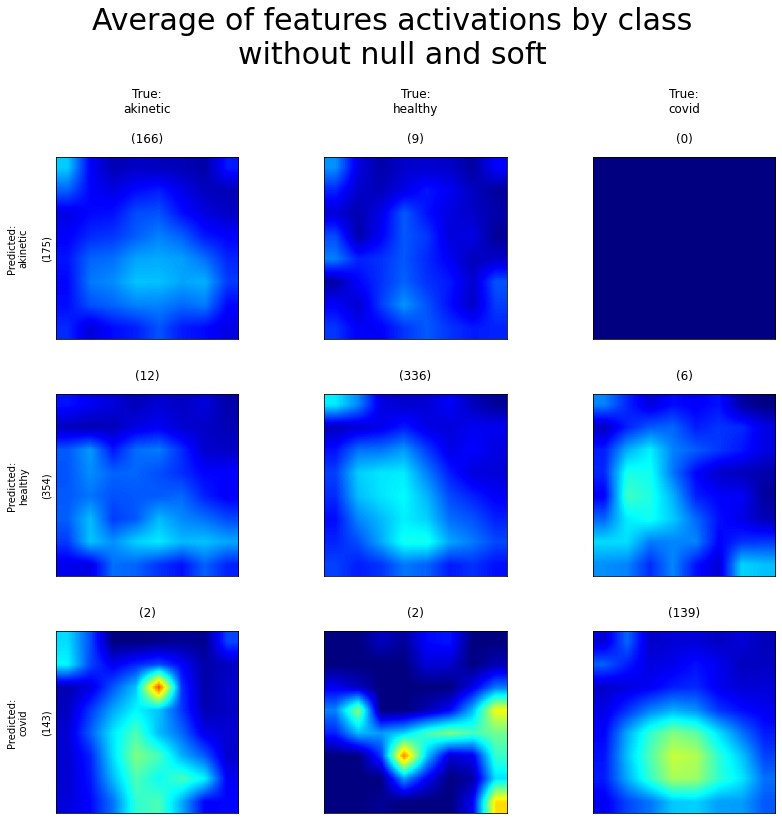

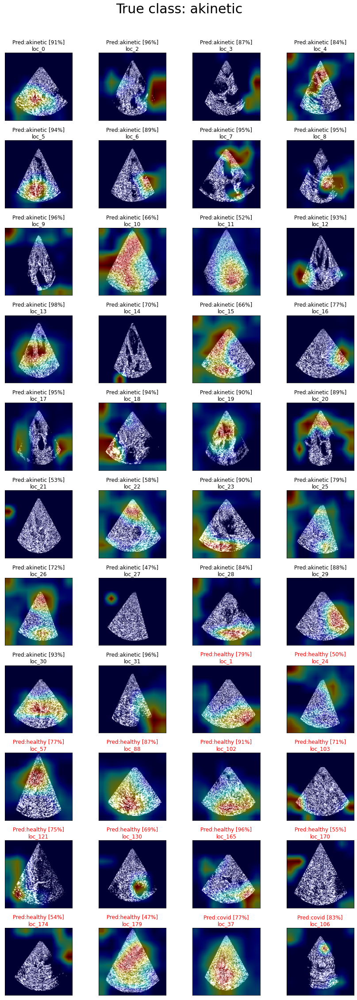

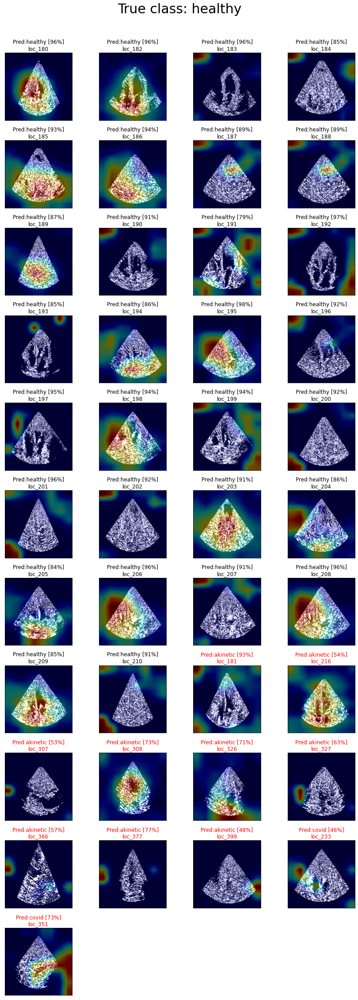

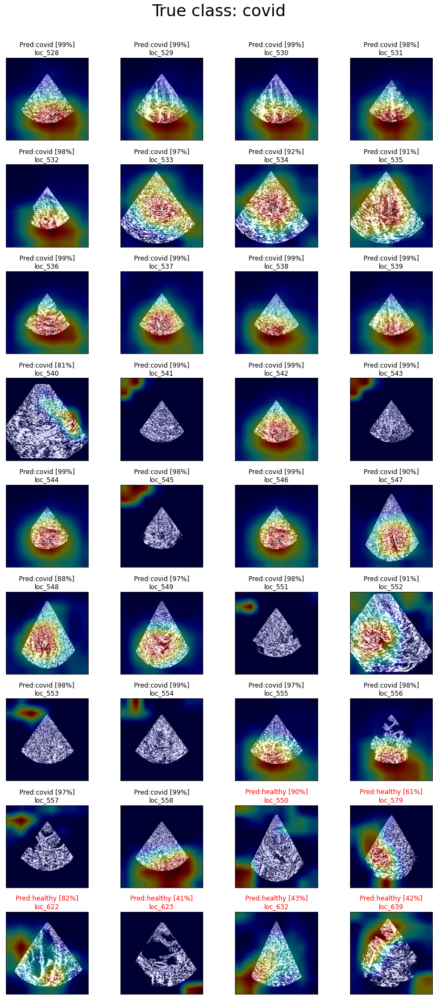

In [12]:
# evaluate features visualization

new_index = np.array(dataset.df.index)
multi_class = True
model = Resnet34FeatVis(num_channels=49, num_classes=3)
reload_model_ID = 'Multiclass_Resnet34_FocLos_full'
model_ID = 'Multiclass_Resnet34_FocLos'
save_path = 'Multiclass'

fvu = FeaturesVisualizationUtils(save_path=save_path,
                                 model_ID=model_ID,
                                 image_size = size)
fvu.run_features_visualization(dataset=dataset,
                               new_index=new_index,
                               model=model,
                               reload_model_ID=reload_model_ID,
                               multi_class=multi_class,
                               gradient_aggregation='mean',
                               apply_soft_activation=True,
                               nn_to_replace=nn.ReLU,
                               nn_replacement=nn.LeakyReLU(inplace=True),
                               frame_to_show=0)
fvu.plot_heatmap(fig_size = 12)
fvu.plot_sample_masked(fig_size = 12, max_sample_combination = 30, sample_ncol = 4)
fvu.plot_heatmap_max_distribution()

## Create Dataset with original frames

In [15]:
input_name = 'eco_50_first_Nodiff_samplFirst_mask_256'

frame_to_keep = 50
frame_sampling = 'first_available' # 'equally_spaced' 
apply_frame_difference = False
apply_sampling_first = True  # if True, apply sampling first and then frame difference (if any). If False, reverse order
apply_mask = True
resize = 256
output_folder = os.path.join('./input/', input_name)
metadata_out = os.path.join('./input/', 'MetaData_' + input_name + '.csv')

In [16]:
# create dataset

metadata_raw = pd.read_csv('./input/Clip_MetaDataUpdate.csv')
create_model_input(metadata_raw, output_folder, metadata_out, frame_to_keep, frame_sampling, apply_frame_difference,
                   apply_sampling_first, apply_mask, resize)


Total removed: 54
    - because of color: 3
    - because of number of frames: 51

Total remaining: 678 out of 732 



,count,out of
diagnosis,,
akinetic,180,203
covid,150,159
healthy,348,370



Raw pickle folder size: 33,966 MB

Total number of frames will be: 50 

732 / 732
Total elapsed time: 0:05:07

Files saved in ./input/eco_50_first_Nodiff_samplFirst_mask_256
Output folder size: 2,119 MB

Model metadata saved in ./input/MetaData_eco_50_first_Nodiff_samplFirst_mask_256.csv


## Train model Akinetic vs Rest

In [4]:
input_name = 'eco_50_first_Nodiff_samplFirst_mask_256'
size = 256
diagnosis_class = pd.DataFrame({'diagnosis': ['akinetic', 'healthy', 'covid'],
                                'label': [1, 0, 0],
                                'meaning': ['akinetic', 'other', 'other']})


dataset = ecoSaccoDataset(input_name, diagnosis_class=diagnosis_class, diagnosis_to_keep=['akinetic', 'healthy', 'covid'],
                          size=size, show_info=True)

ecoSaccoDataset initialized with size=256, augment=None
Dataset is located in ./input/eco_50_first_Nodiff_samplFirst_mask_256

############    eco_50_first_Nodiff_samplFirst_mask_256 dataset    ############

Total files: 678
Total frames: 50


,image,label,meaning,source
0,./input/eco_50_first_Nodiff_samplFirst_mask_25...,1,akinetic,Sacco
1,./input/eco_50_first_Nodiff_samplFirst_mask_25...,1,akinetic,Sacco
2,./input/eco_50_first_Nodiff_samplFirst_mask_25...,1,akinetic,Sacco
3,./input/eco_50_first_Nodiff_samplFirst_mask_25...,1,akinetic,Sacco
4,./input/eco_50_first_Nodiff_samplFirst_mask_25...,1,akinetic,Sacco
...,...,...,...,...
673,./input/eco_50_first_Nodiff_samplFirst_mask_25...,0,other,Sacco
674,./input/eco_50_first_Nodiff_samplFirst_mask_25...,0,other,Sacco
675,./input/eco_50_first_Nodiff_samplFirst_mask_25...,0,other,Sacco
676,./input/eco_50_first_Nodiff_samplFirst_mask_25...,0,other,Sacco


,,,count
label,meaning,source,
0,other,Sacco,498
1,akinetic,Sacco,180



Used raw classifier: Resnet34

Start hyperparameter tuning


============================== BCE - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,other,Sacco,398,398,398,399,399
1,akinetic,Sacco,144,144,144,144,144



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,other,Sacco,100,100,100,99,99
1,akinetic,Sacco,36,36,36,36,36



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa1c2541250>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.748# 0.465  0.346  | 0.779* 0.497  0.465  |   7.28
                    |                      | 0.747# 0.504  0.351  |   7.28
0.010000   18   2.0 | 0.948# 0.584  0.265  | 0.724* 0.612  0.555  |  14.36
                    |                      | 0.956# 0.566  0.266  |  14.36
0.009000   27   3.0 | 1.037# 0.542  0.265  | 0.648* 0.731  0.627  |  21.44
       

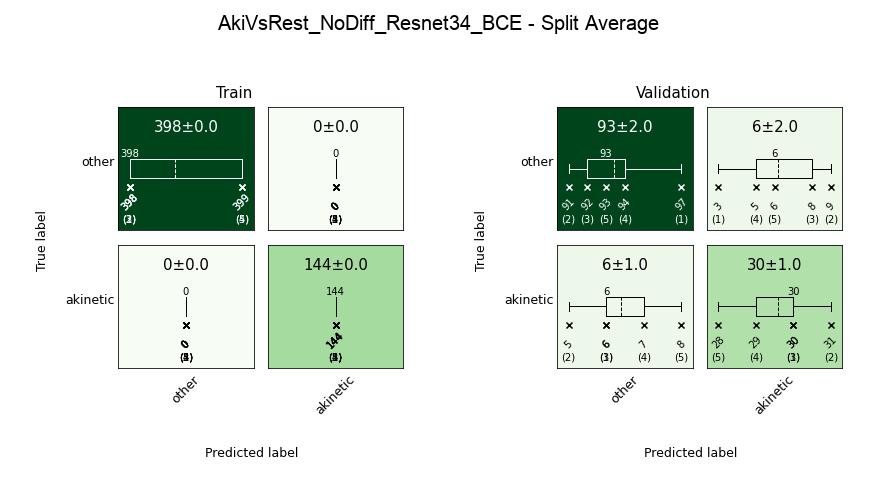



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.378 ± 0.107,0.949 ± 0.018,0.907 ± 0.016,0.002 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.825 ± 0.027,1.0 ± 0.0,0.937 ± 0.012





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,other,Sacco,398,100
1,akinetic,Sacco,144,36


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa1c2541250>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7fa1c015f730>'
BCELoss()'
[Accuracy(), <function roc_auc_score at 0x7fa1c26b1040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.922# 0.521  0.272  | 0.788* 0.489  0.454  |   7.04
                    |                      | 0.911# 0.58

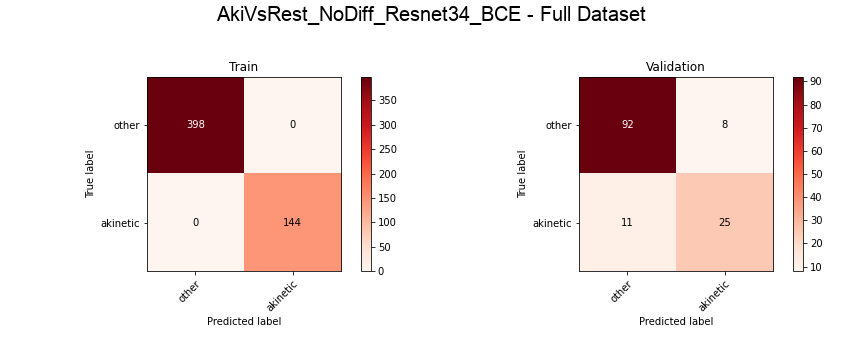

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
other                1      1      1.0     398       0.89   0.92     0.91   
akinetic             1      1      1.0     144       0.76   0.69     0.72   
accuracy                           1.0     542                       0.86   
macro avg            1      1      1.0     542       0.83   0.81     0.82   
weighted avg         1      1      1.0     542       0.86   0.86     0.86   

                      
             support  
other            100  
akinetic          36  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.378 ± 0.107,0.949 ± 0.018,0.907 ± 0.016,0.002 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.825 ± 0.027,1.0 ± 0.0,0.937 ± 0.012
Full,0.531,0.872,0.86,0.001,1,1,1,0.725,1,0.906


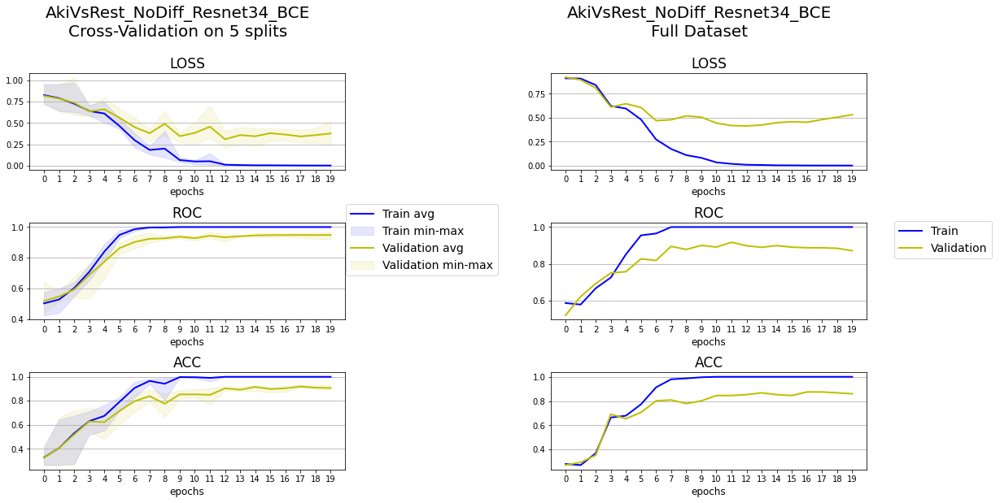

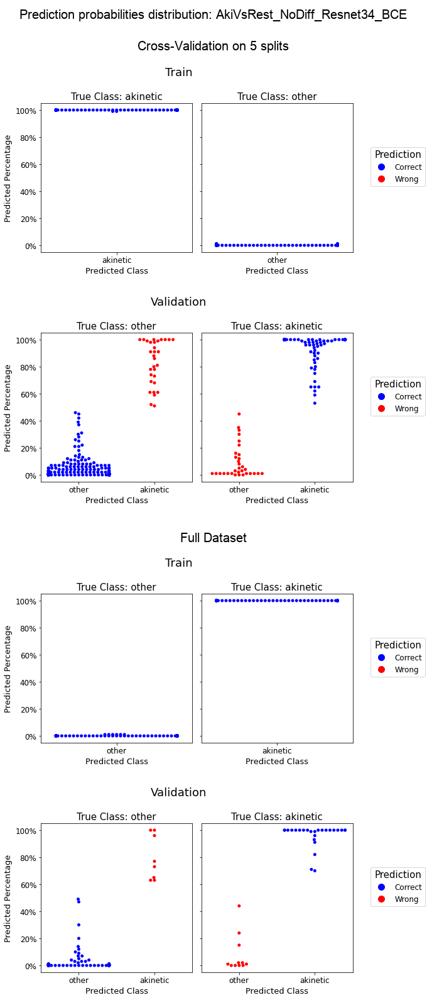



============================== BCE - InvertClass:yes ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,other,Sacco,398,398,398,399,399



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,other,Sacco,100,100,100,99,99



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa19c4ed040>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.630# 0.508  0.684  | 0.742* 0.530  0.522  |   6.90
                    |                      | 0.634# 0.532  0.664  |   6.90
0.010000   18   2.0 | 0.692# 0.497  0.515  | 0.684* 0.654  0.601  |  13.79
                    |                      | 0.713# 0.488  0.507  |  13.79
0.009000   27   3.0 | 0.612# 0.657  0.684  | 0.610* 0.756  0.668  |  20.70
       

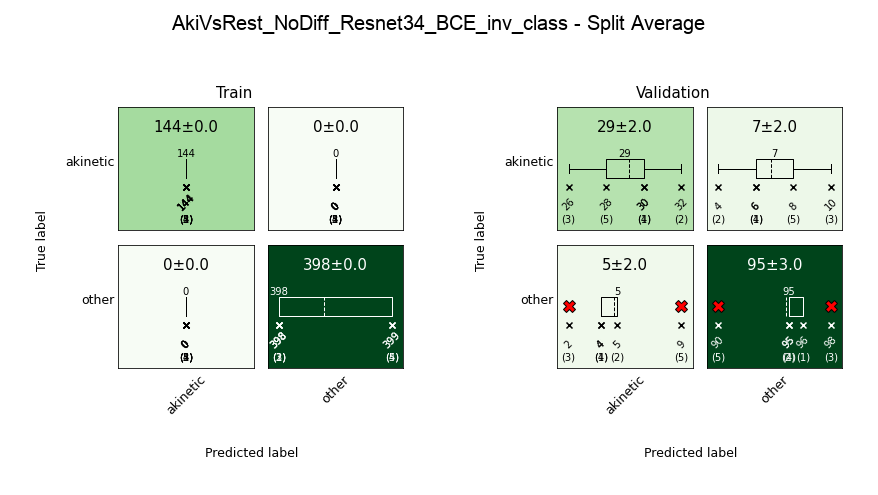



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.341 ± 0.059,0.95 ± 0.021,0.914 ± 0.024,0.001 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.834 ± 0.044,1.0 ± 0.0,0.942 ± 0.017





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,other,Sacco,398,100


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa19c4ed040>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7fa15bd9ff70>'
BCELoss()'
[Accuracy(), <function roc_auc_score at 0x7fa1c26b1040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.638# 0.486  0.728  | 0.732* 0.553  0.530  |   7.01
                    |                      | 0.628# 0.53

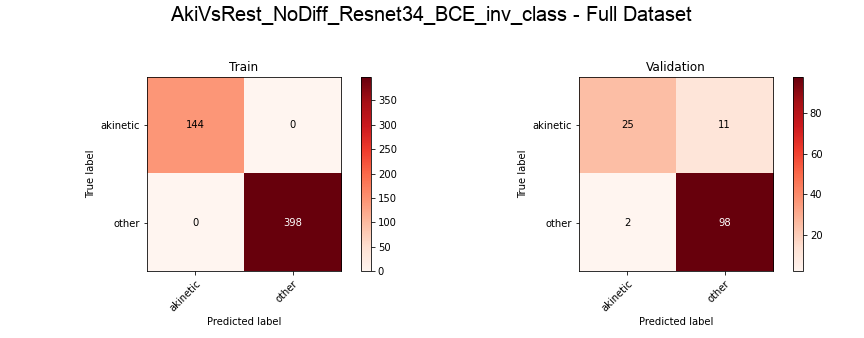

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1      1      1.0     144       0.93   0.69     0.79   
other                1      1      1.0     398        0.9   0.98     0.94   
accuracy                           1.0     542                       0.90   
macro avg            1      1      1.0     542       0.91   0.84     0.87   
weighted avg         1      1      1.0     542       0.91    0.9     0.90   

                      
             support  
akinetic          36  
other            100  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.341 ± 0.059,0.95 ± 0.021,0.914 ± 0.024,0.001 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.834 ± 0.044,1.0 ± 0.0,0.942 ± 0.017
Full,0.356,0.929,0.904,0.001,1,1,1,0.794,1,0.938


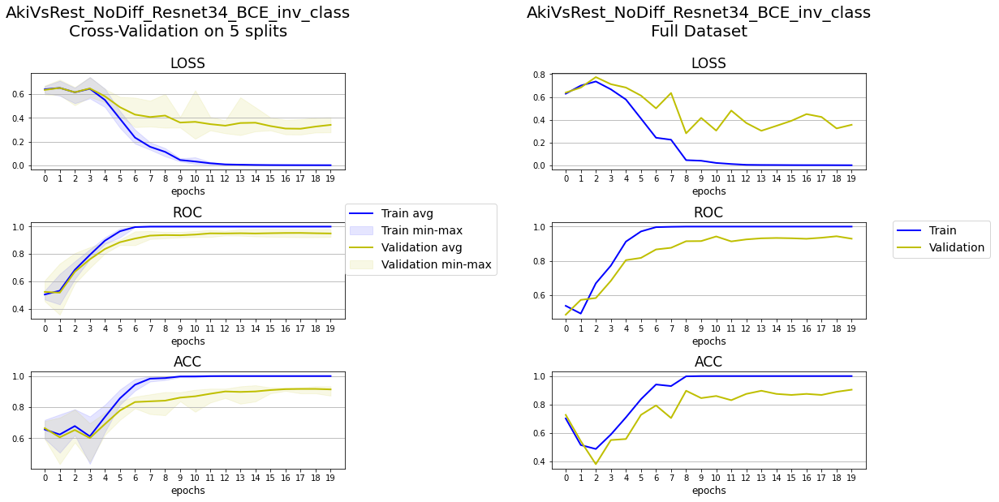

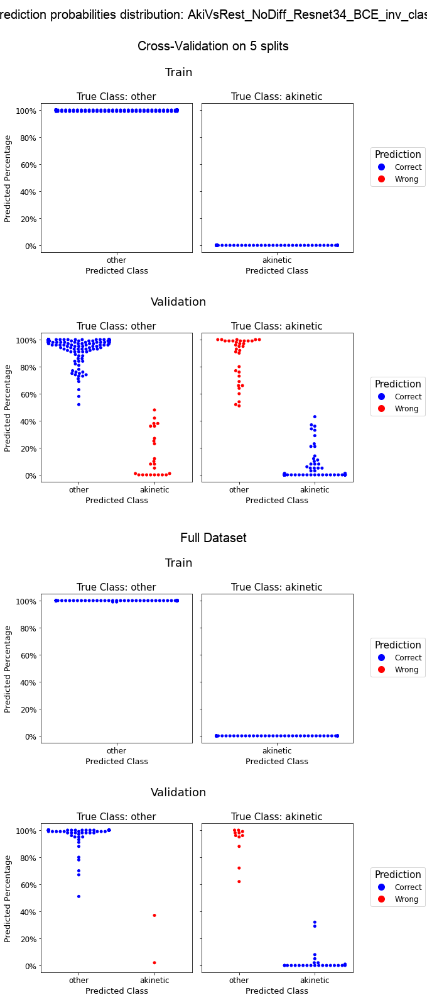



============================== FocLos - InvertClass:no ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,other,Sacco,398,398,398,399,399
1,akinetic,Sacco,144,144,144,144,144



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,other,Sacco,100,100,100,99,99
1,akinetic,Sacco,36,36,36,36,36



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa19c624ee0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.236# 0.411  0.353  | 0.304* 0.495  0.507  |   6.90
                    |                      | 0.216# 0.562  0.399  |   6.90
0.010000   18   2.0 | 0.319# 0.424  0.287  | 0.264* 0.609  0.548  |  13.77
                    |                      | 0.298# 0.572  0.332  |  13.77
0.009000   27   3.0 | 0.508# 0.459  0.265  | 0.220* 0.661  0.581  |  20.68
       

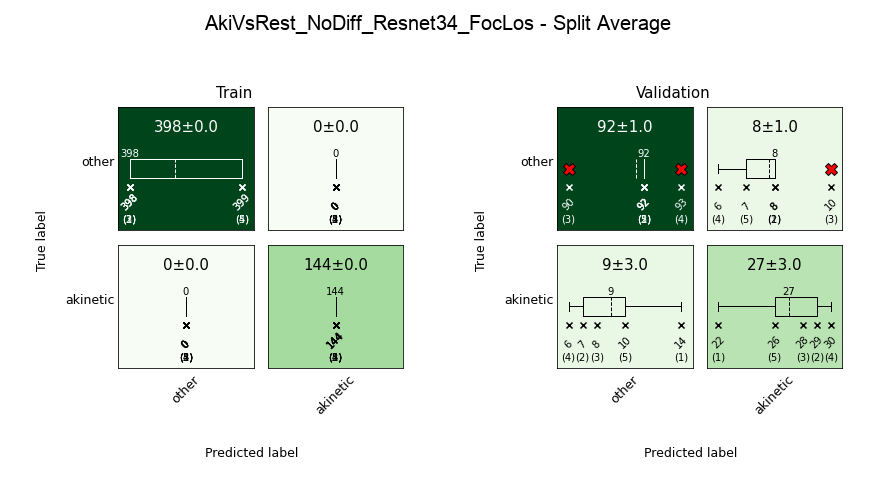



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.141 ± 0.033,0.926 ± 0.026,0.876 ± 0.027,0.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.761 ± 0.062,1.0 ± 0.0,0.916 ± 0.017





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,other,Sacco,398,100
1,akinetic,Sacco,144,36


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa19c624ee0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7fa15afcbd30>'
FocalLoss()'
[Accuracy(), <function roc_auc_score at 0x7fa1c26b1040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.276# 0.449  0.265  | 0.280* 0.518  0.506  |   7.04
                    |                      | 0.273# 0.

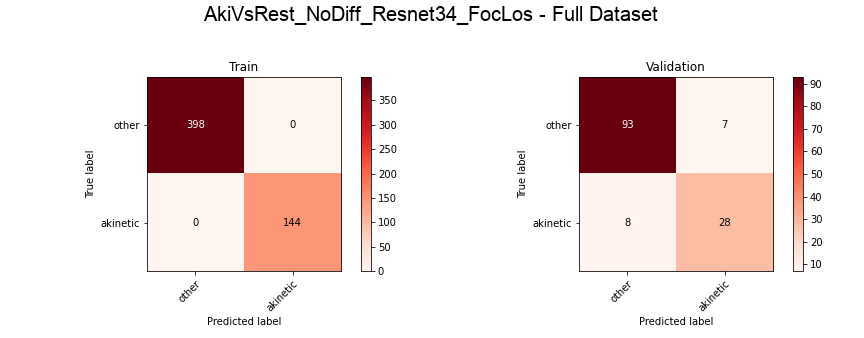

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
other                1      1      1.0     398       0.92   0.93     0.93   
akinetic             1      1      1.0     144        0.8   0.78     0.79   
accuracy                           1.0     542                       0.89   
macro avg            1      1      1.0     542       0.86   0.85     0.86   
weighted avg         1      1      1.0     542       0.89   0.89     0.89   

                      
             support  
other            100  
akinetic          36  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.141 ± 0.033,0.926 ± 0.026,0.876 ± 0.027,0.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.761 ± 0.062,1.0 ± 0.0,0.916 ± 0.017
Full,0.108,0.952,0.89,0,1,1,1,0.789,1,0.925


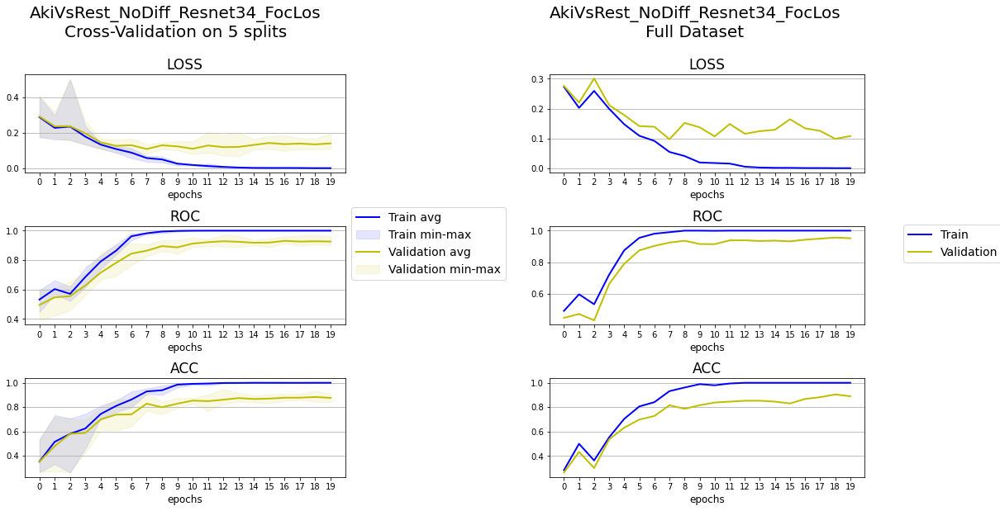

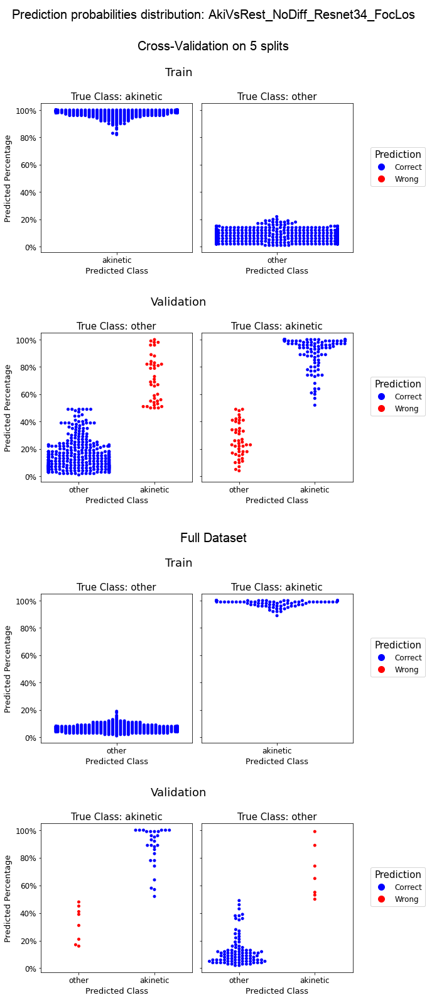



============================== FocLos - InvertClass:yes ==============================


Executing a 5-fold cross validation

Train distribution for each split:


,,,train_1,train_2,train_3,train_4,train_5
label,meaning,source,,,,,
0,akinetic,Sacco,144,144,144,144,144
1,other,Sacco,398,398,398,399,399



Validation distribution for each split:


,,,valid_1,valid_2,valid_3,valid_4,valid_5
label,meaning,source,,,,,
0,akinetic,Sacco,36,36,36,36,36
1,other,Sacco,100,100,100,99,99



=== Split #1 ===

Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa1a4be37c0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.160# 0.450  0.691  | 0.269* 0.532  0.520  |   6.97
                    |                      | 0.154# 0.526  0.701  |   6.97
0.010000   18   2.0 | 0.167# 0.566  0.610  | 0.212* 0.687  0.614  |  13.95
                    |                      | 0.181# 0.511  0.563  |  13.95
0.009000   27   3.0 | 0.183# 0.566  0.544  | 0.188* 0.737  0.609  |  20.93
       

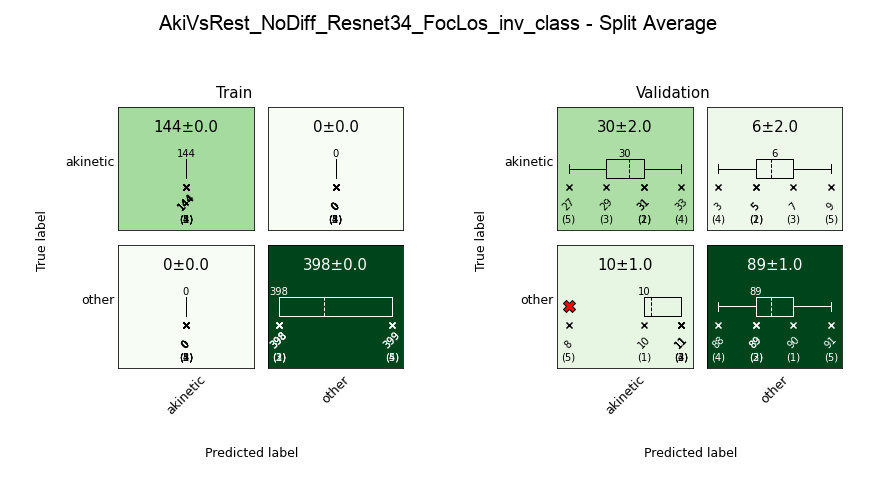



Average Performance:


,Valid_Loss_Avg,Valid_ROC_Avg,Valid_Acc_Avg,Train_Loss_Avg,Train_ROC_Avg,Train_Acc_Avg,train_akinetic_f1-score_Avg,valid_akinetic_f1-score_Avg,train_other_f1-score_Avg,valid_other_f1-score_Avg
0,0.148 ± 0.019,0.931 ± 0.024,0.882 ± 0.012,0.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.79 ± 0.028,1.0 ± 0.0,0.918 ± 0.007





=== Full Dataset ===


Distribution for full dataset:


,,,train,validation
label,meaning,source,,
0,akinetic,Sacco,144,36
1,other,Sacco,398,100


Trainer started with classifier: Resnet34
dataset: <datasets.ecoSaccoDataset.ecoSaccoDataset object at 0x7fa1a4be37c0>
batch size: 64
Train set: 542
Validation set: 136
Training with 9 mini-batches per epoch
Logging performance every 2 iter, smoothing every: 9 iter, saving checkpoints every 45 iter
SGD (
Parameter Group 0
    dampening: 0
    initial_lr: 0.01
    lr: 0.01
    momentum: 0.9
    nesterov: False
    weight_decay: 0.0001
)'
<torch.optim.lr_scheduler.StepLR object at 0x7fa15a210eb0>'
FocalLoss()'
[Accuracy(), <function roc_auc_score at 0x7fa1c26b1040>]'

* performance with model.train()
# performance with model.eval()
                    |         VALID        |        TRAIN         |         
 lr     iter  epoch | loss    roc    acc   | loss    roc    acc   |  time   
------------------------------------------------------------------------------
0.010000    9   1.0 | 0.156# 0.542  0.691  | 0.268* 0.555  0.555  |   7.08
                    |                      | 0.159# 0.

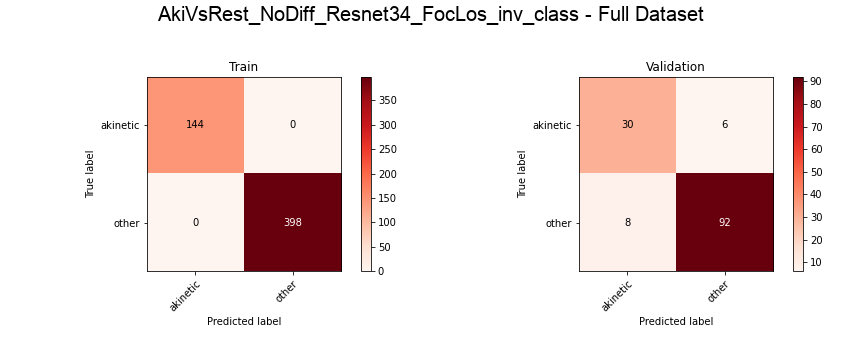

Train                         Validation                  \
             precision recall f1-score support  precision recall f1-score   
akinetic             1      1      1.0     144       0.79   0.83     0.81   
other                1      1      1.0     398       0.94   0.92     0.93   
accuracy                           1.0     542                       0.90   
macro avg            1      1      1.0     542       0.86   0.88     0.87   
weighted avg         1      1      1.0     542        0.9    0.9     0.90   

                      
             support  
akinetic          36  
other            100  
accuracy         136  
macro avg        136  
weighted avg     136


Performance summary:


,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score
Set,,,,,,,,,,
Cross-Validation,0.148 ± 0.019,0.931 ± 0.024,0.882 ± 0.012,0.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.79 ± 0.028,1.0 ± 0.0,0.918 ± 0.007
Full,0.101,0.951,0.897,0,1,1,1,0.811,1,0.929


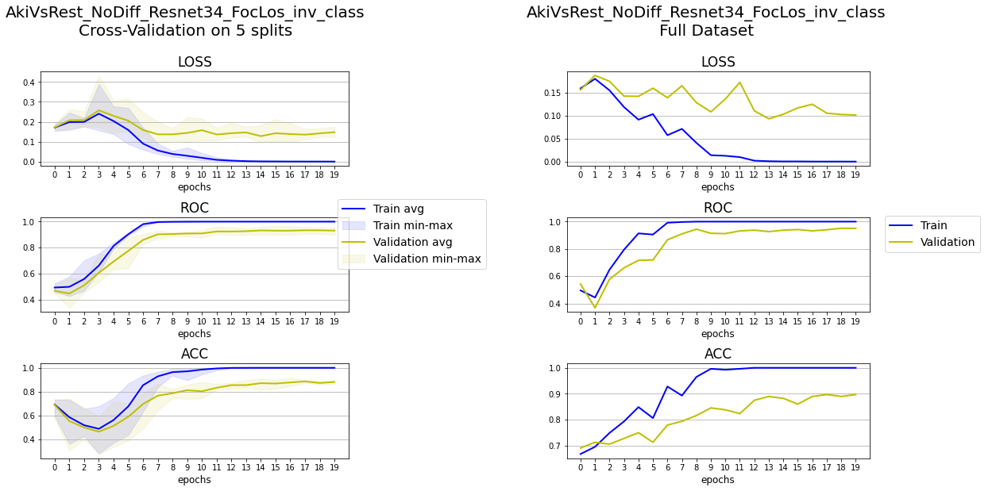

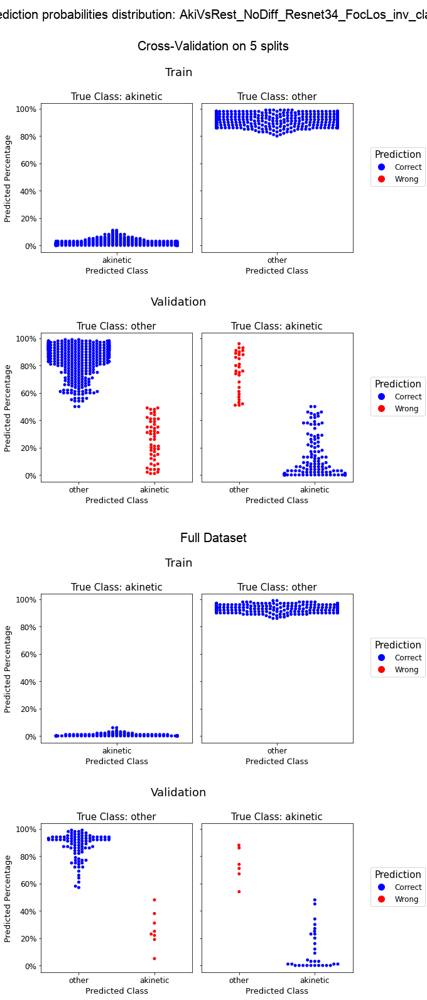




Final Log:


,session_ID,valid_loss,valid_roc,valid_acc,train_loss,train_roc,train_acc,train_akinetic_f1-score,valid_akinetic_f1-score,train_other_f1-score,valid_other_f1-score,loss,inverted_class,model_ID
Cross-Validation,AkiVsRest_NoDiff_Resnet34_BCE,0.378 ± 0.107,0.949 ± 0.018,0.907 ± 0.016,0.002 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.825 ± 0.027,1.0 ± 0.0,0.937 ± 0.012,BCE,no,Resnet34
Full,AkiVsRest_NoDiff_Resnet34_BCE,0.531,0.872,0.86,0.001,1,1,1,0.725,1,0.906,BCE,no,Resnet34
Cross-Validation,AkiVsRest_NoDiff_Resnet34_BCE_inv_class,0.341 ± 0.059,0.95 ± 0.021,0.914 ± 0.024,0.001 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.834 ± 0.044,1.0 ± 0.0,0.942 ± 0.017,BCE,yes,Resnet34
Full,AkiVsRest_NoDiff_Resnet34_BCE_inv_class,0.356,0.929,0.904,0.001,1,1,1,0.794,1,0.938,BCE,yes,Resnet34
Cross-Validation,AkiVsRest_NoDiff_Resnet34_FocLos,0.141 ± 0.033,0.926 ± 0.026,0.876 ± 0.027,0.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.761 ± 0.062,1.0 ± 0.0,0.916 ± 0.017,FocLos,no,Resnet34
Full,AkiVsRest_NoDiff_Resnet34_FocLos,0.108,0.952,0.89,0,1,1,1,0.789,1,0.925,FocLos,no,Resnet34
Cross-Validation,AkiVsRest_NoDiff_Resnet34_FocLos_inv_class,0.148 ± 0.019,0.931 ± 0.024,0.882 ± 0.012,0.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,1.0 ± 0.0,0.79 ± 0.028,1.0 ± 0.0,0.918 ± 0.007,FocLos,yes,Resnet34
Full,AkiVsRest_NoDiff_Resnet34_FocLos_inv_class,0.101,0.951,0.897,0,1,1,1,0.811,1,0.929,FocLos,yes,Resnet34


In [5]:
# cross-validate and train model on full set - hyperparameter tuning for loss_set and invert_class_set

trainer_ID = 'AkiVsRest_NoDiff'
base_classifier_ID = Resnet34(num_channels=50)
dataset = dataset


cvu.tune_with_CV(trainer_ID = trainer_ID,
                 dataset = dataset,
                 base_classifier_ID = base_classifier_ID,
                 batch_size = batch_size,
                 n_splits = 5,
                 max_epochs_split = 20,
                 max_epochs_full = 20,
                 stratify_lab = dataset.labels,
                 loss_set = ['BCE', 'FocLos'],
                 invert_class_set = True,
                 measure_to_plot = ['loss', 'roc', 'acc'],
                 metrics = [Accuracy(), roc_auc_score],
                 show_info=False, show_log=2, show_perf_plot=True,
                 save_split_checkpoint=False, save_split_final=True,
                 save_full_checkpoint=False, save_full_final=True,
                 reload_split=False, reload_full=False)

# reload final performance log
final_log=pd.read_csv(os.path.join('results', trainer_ID, trainer_ID+'_final_performance.csv'), sep=';', index_col=0)

Evaluating heatmap:

 -- Gradient aggregation: mean
 -- Soft activation is applied to <class 'torch.nn.modules.activation.ReLU'> , replaced with LeakyReLU(negative_slope=0.01, inplace=True)



/home/alessandro/.conda/envs/defeatcovid19/lib/python3.8/site-packages/torch/serialization.py:593: SourceChangeWarning: source code of class 'models.resnet34.Resnet34' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)


Processing 7/7 batch - Total elapsed time: 0:00:42
Done




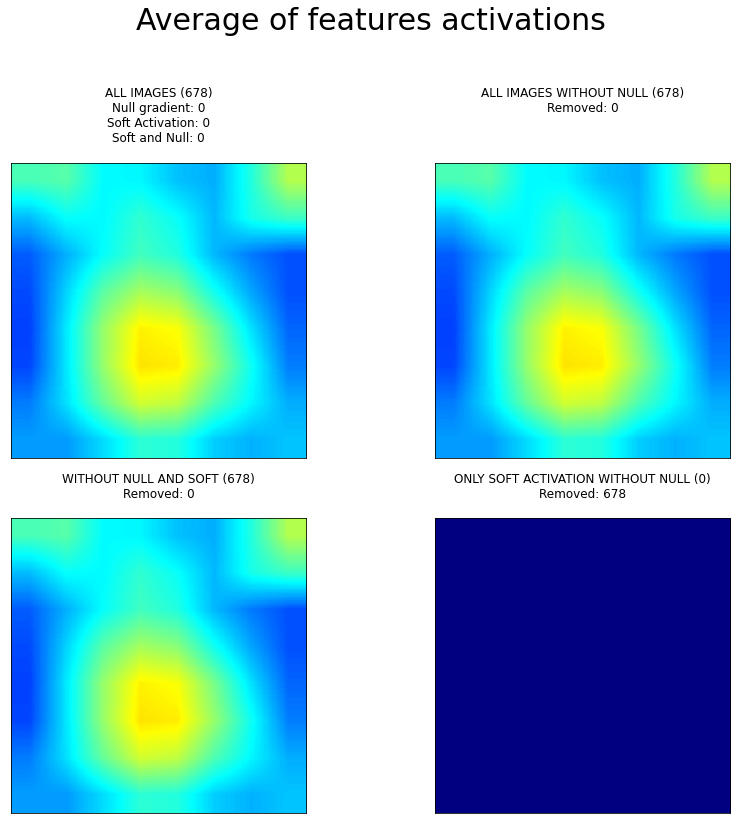

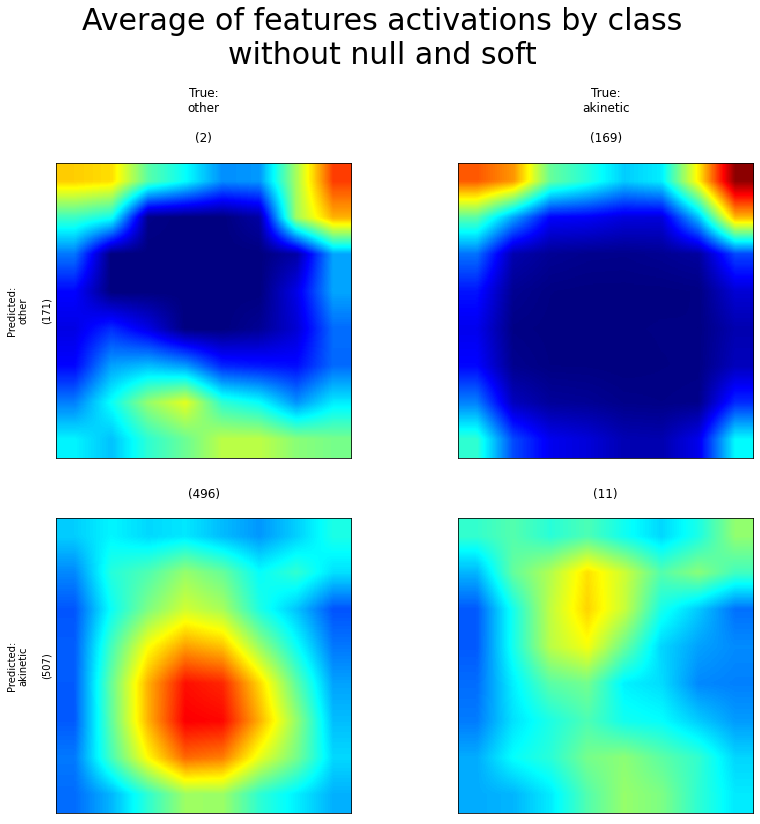

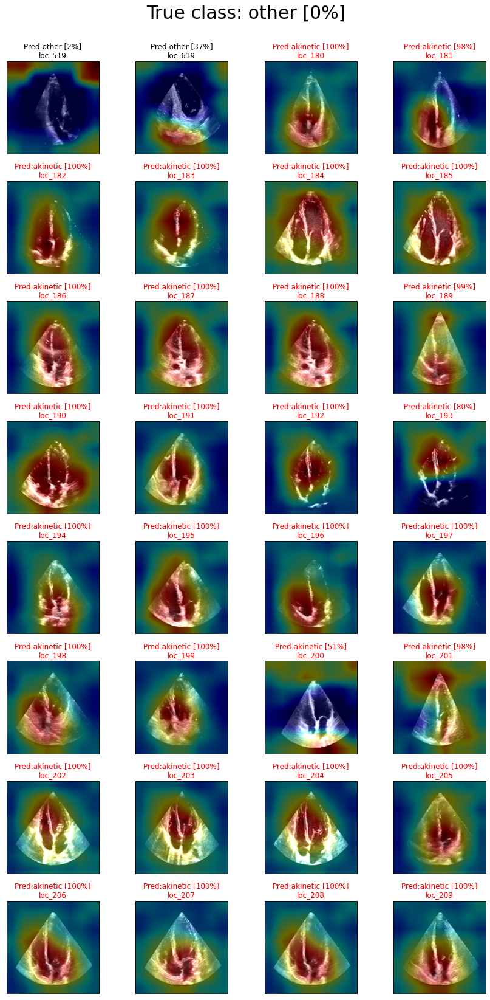

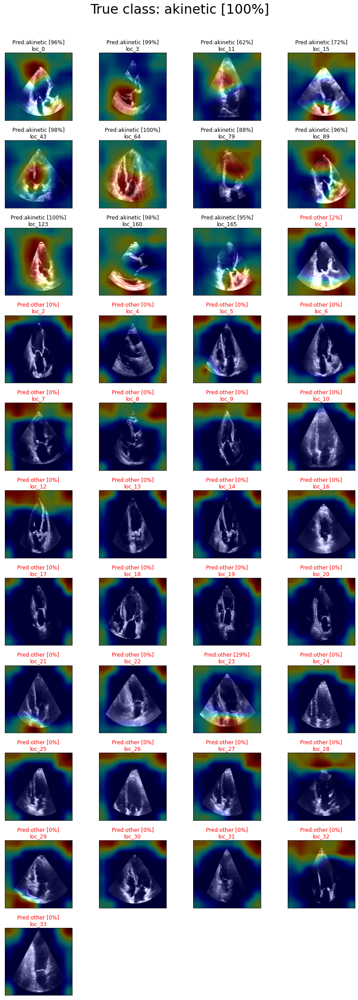

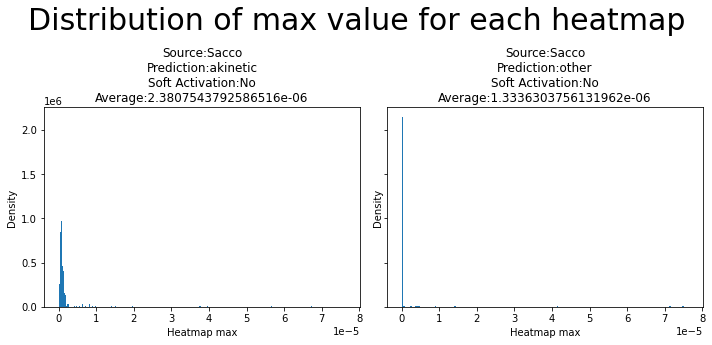

In [5]:
# evaluate features visualization

new_index = np.array(dataset.df.index)
multi_class = False
model = Resnet34FeatVis(num_channels=50)
reload_model_ID = 'AkiVsRest_NoDiff_Resnet34_BCE_inv_class_full'
model_ID = 'AkiVsRest_NoDiff_Resnet34_BCE_inv_class'
save_path = 'AkiVsRest_NoDiff'

fvu = FeaturesVisualizationUtils(save_path=save_path,
                                 model_ID=model_ID,
                                 image_size = size)
fvu.run_features_visualization(dataset=dataset,
                               new_index=new_index,
                               model=model,
                               reload_model_ID=reload_model_ID,
                               multi_class=multi_class,
                               gradient_aggregation='mean',
                               apply_soft_activation=True,
                               nn_to_replace=nn.ReLU,
                               nn_replacement=nn.LeakyReLU(inplace=True),
                               frame_to_show=0)
fvu.plot_heatmap(fig_size = 12)
fvu.plot_sample_masked(fig_size = 12, max_sample_combination = 30, sample_ncol = 4)
fvu.plot_heatmap_max_distribution()

# Train Akinetic vs Healthy

In [ ]:
input_name = 'eco_50_first_Nodiff_samplFirst_mask_256'
size = 256

dataset = ecoSaccoDataset(input_name, diagnosis_class=None, diagnosis_to_keep=['akinetic', 'healthy'],
                          size=size, show_info=True)

In [ ]:
# cross-validate and train model on full set - hyperparameter tuning for loss_set and invert_class_set

trainer_ID = 'AkiVsHealth_NoDiff'
base_classifier_ID = Resnet34(num_channels=50)
dataset = dataset


cvu.tune_with_CV(trainer_ID = trainer_ID,
                 dataset = dataset,
                 base_classifier_ID = base_classifier_ID,
                 batch_size = batch_size,
                 n_splits = 5,
                 max_epochs_split = 20,
                 max_epochs_full = 20,
                 stratify_lab = dataset.labels,
                 loss_set = ['BCE', 'FocLos'],
                 invert_class_set = True,
                 measure_to_plot = ['loss', 'roc', 'acc'],
                 metrics = [Accuracy(), roc_auc_score],
                 show_info=False, show_log=2, show_perf_plot=True,
                 save_split_checkpoint=False, save_split_final=True,
                 save_full_checkpoint=False, save_full_final=True,
                 reload_split=False, reload_full=False)

# reload final performance log
final_log=pd.read_csv(os.path.join('results', trainer_ID, trainer_ID+'_final_performance.csv'), sep=';', index_col=0)

In [ ]:
# evaluate features visualization

new_index = np.array(dataset.df.index)
multi_class = False
model = Resnet34FeatVis(num_channels=49)
reload_model_ID = 'AkiVsHealth_NoDiff_Resnet34_BCE_inv_class_full'
model_ID = 'AkiVsHealth_NoDiff_Resnet34_BCE_inv_class'
save_path = 'AkiVsHealth_NoDiff'

fvu = FeaturesVisualizationUtils(save_path=save_path,
                                 model_ID=model_ID,
                                 image_size = size)
fvu.run_features_visualization(dataset=dataset,
                               new_index=new_index,
                               model=model,
                               reload_model_ID=reload_model_ID,
                               multi_class=multi_class,
                               gradient_aggregation='mean',
                               apply_soft_activation=True,
                               nn_to_replace=nn.ReLU,
                               nn_replacement=nn.LeakyReLU(inplace=True),
                               frame_to_show=0)
fvu.plot_heatmap(fig_size = 12)
fvu.plot_sample_masked(fig_size = 12, max_sample_combination = 30, sample_ncol = 4)
fvu.plot_heatmap_max_distribution()

## Train multiclass model

In [ ]:
input_name = 'eco_50_first_Nodiff_samplFirst_mask_256'
size = 256

dataset = ecoSaccoDataset(input_name, diagnosis_class=None, diagnosis_to_keep=['akinetic', 'healthy', 'covid'],
                          size=size, show_info=True)

In [ ]:
# cross-validate and train model on full set - hyperparameter tuning for loss_set and invert_class_set

trainer_ID = 'Multiclass_NoDiff'
base_classifier_ID = Resnet34(num_channels=50, num_classes=3)
dataset = dataset


aa=cvu.tune_with_CV(trainer_ID = trainer_ID,
                 dataset = dataset,
                 base_classifier_ID = base_classifier_ID,
                 batch_size = batch_size,
                 n_splits = 5,
                 max_epochs_split = 20,
                 max_epochs_full = 20,
                 stratify_lab = dataset.labels,
                 loss_set = ['NLL', 'FocLos'],
                 multi_class=True,
                 invert_class_set = True,
                 measure_to_plot = ['loss', 'roc', 'acc'],
                 metrics = [AccuracyMulti(ordered_class_labels=sorted(dataset.df.label.unique())), ROCMulti()],
                 show_info=False, show_log=2, show_perf_plot=True,
                 save_split_checkpoint=False, save_split_final=True,
                 save_full_checkpoint=False, save_full_final=True,
                 reload_split=False, reload_full=False)

# reload final performance log
final_log=pd.read_csv(os.path.join('results', trainer_ID, trainer_ID+'_final_performance.csv'), sep=';', index_col=0)

In [ ]:
# evaluate features visualization

new_index = np.array(dataset.df.index)
multi_class = True
model = Resnet34FeatVis(num_channels=49, num_classes=3)
reload_model_ID = 'Multiclass_NoDiff_Resnet34_FocLos_full'
model_ID = 'Multiclass_NoDiff_Resnet34_FocLos'
save_path = 'Multiclass_NoDiff'

fvu = FeaturesVisualizationUtils(save_path=save_path,
                                 model_ID=model_ID,
                                 image_size = size)
fvu.run_features_visualization(dataset=dataset,
                               new_index=new_index,
                               model=model,
                               reload_model_ID=reload_model_ID,
                               multi_class=multi_class,
                               gradient_aggregation='mean',
                               apply_soft_activation=True,
                               nn_to_replace=nn.ReLU,
                               nn_replacement=nn.LeakyReLU(inplace=True),
                               frame_to_show=0)
fvu.plot_heatmap(fig_size = 12)
fvu.plot_sample_masked(fig_size = 12, max_sample_combination = 30, sample_ncol = 4)
fvu.plot_heatmap_max_distribution()